In [1]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch

torch.cuda.empty_cache()

In [2]:
scale_image_path = '../images/cropped_scales/fixed'
images_scale = [os.path.join(scale_image_path, f) for f in os.listdir(scale_image_path) if f.endswith('only.jpg')]
images_full = [os.path.join(scale_image_path, f) for f in os.listdir(scale_image_path) if 'grid' not in f and 'only' not in f]

In [3]:
def draw_right_half_contours(image_path):
    # Load the image
    image = cv2.imread(image_path)

    # Convert to HSV (Hue, Saturation, Value) color space for easier color segmentation
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)

    # Define range of bright colors in HSV
    lower_color = np.array([0, 100, 100])
    upper_color = np.array([179, 255, 255])

    # Threshold the HSV image to get only bright colors
    mask = cv2.inRange(hsv, lower_color, upper_color)

    # Find contours in the mask
    contours, _ = cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # Filter out small contours that are not our boxes
    box_contours = [cnt for cnt in contours if cv2.contourArea(cnt) > 100]

    # Calculate bounding boxes for each contour
    bounding_boxes = [cv2.boundingRect(cnt) for cnt in box_contours]

    # Determine the midpoint of the image width
    midpoint = image.shape[1] / 2

    # Keep only the boxes that have an x-coordinate greater than the midpoint
    right_half_boxes = [box for box in bounding_boxes if box[0] > midpoint]

    # Sort these boxes by their x-coordinate to ensure rightmost first
    sorted_right_half_boxes = sorted(right_half_boxes, key=lambda x: x[0], reverse=True)

    # Draw these seven boxes on the image
    for (x, y, w, h) in sorted_right_half_boxes:
        cv2.rectangle(image, (x, y), (x+w, y+h), (0, 255, 0), 2)

    # Calculate the total width in pixels of these seven boxes
    total_width_in_pixels = sum([box[2] for box in sorted_right_half_boxes])

    # Since 7 boxes = 4.5 cm, calculate the pixels per cm
    pixels_per_cm = total_width_in_pixels / 5.79

    print(f"Image: {image_path}\n")
    print(f"Pixels per cm: {pixels_per_cm}\n")
    
    # Show the image with the seven boxes drawn
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.show()

Image: ../images/cropped_scales/fixed\1042030204_scale_only.jpg

Pixels per cm: 115.02590673575129



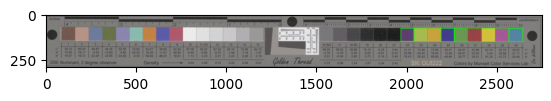

Image: ../images/cropped_scales/fixed\1042031028_scale_only.jpg

Pixels per cm: 103.79965457685665



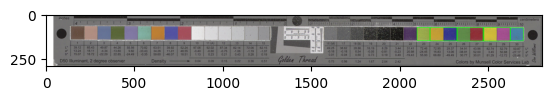

Image: ../images/cropped_scales/fixed\1042032919_scale_only.jpg

Pixels per cm: 115.71675302245251



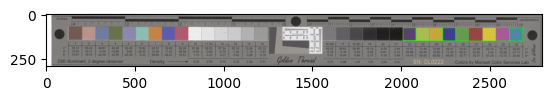

Image: ../images/cropped_scales/fixed\1042033771_scale_only.jpg

Pixels per cm: 115.71675302245251



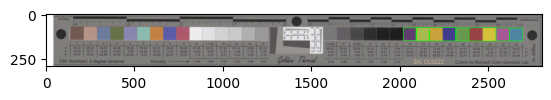

Image: ../images/cropped_scales/fixed\1042050660_scale_only.jpg

Pixels per cm: 103.97236614853195



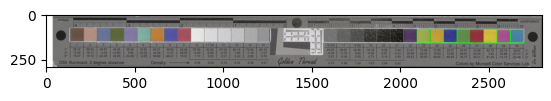

Image: ../images/cropped_scales/fixed\1697946563_scale_only.jpg

Pixels per cm: 115.5440414507772



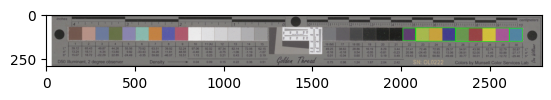

Image: ../images/cropped_scales/fixed\1697946808_scale_only.jpg

Pixels per cm: 115.5440414507772



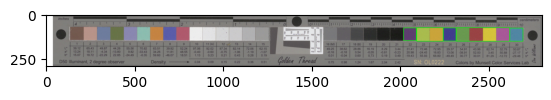

Image: ../images/cropped_scales/fixed\1697947379_scale_only.jpg

Pixels per cm: 118.99827288428325



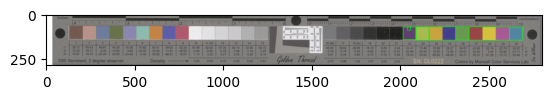

Image: ../images/cropped_scales/fixed\1697949097_scale_only.jpg

Pixels per cm: 114.68048359240069



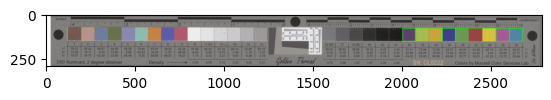

Image: ../images/cropped_scales/fixed\1698011698_scale_only.jpg

Pixels per cm: 115.37132987910189



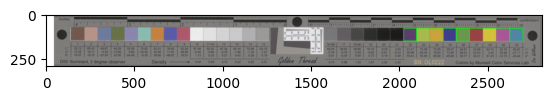

Image: ../images/cropped_scales/fixed\1698012321_scale_only.jpg

Pixels per cm: 114.68048359240069



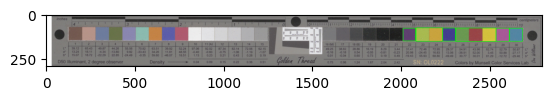

Image: ../images/cropped_scales/fixed\1699427339_scale_only.jpg

Pixels per cm: 115.5440414507772



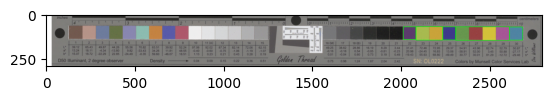

Image: ../images/cropped_scales/fixed\1699619162_scale_only.jpg

Pixels per cm: 117.27115716753022



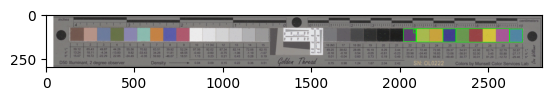

Image: ../images/cropped_scales/fixed\1699916513_scale_only.jpg

Pixels per cm: 119.51640759930915



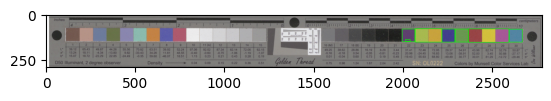

Image: ../images/cropped_scales/fixed\1700731305_scale_only.jpg

Pixels per cm: 115.02590673575129



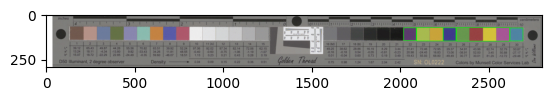

Image: ../images/cropped_scales/fixed\1700731398_scale_only.jpg

Pixels per cm: 114.68048359240069



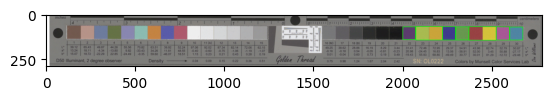

Image: ../images/cropped_scales/fixed\1701221637_scale_only.jpg

Pixels per cm: 115.1986183074266



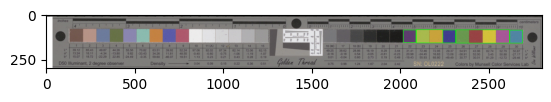

Image: ../images/cropped_scales/fixed\1701222306_scale_only.jpg

Pixels per cm: 115.1986183074266



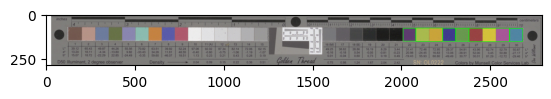

Image: ../images/cropped_scales/fixed\1701222856_scale_only.jpg

Pixels per cm: 115.02590673575129



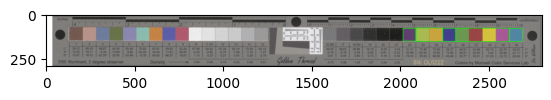

Image: ../images/cropped_scales/fixed\1701223901_scale_only.jpg

Pixels per cm: 115.02590673575129



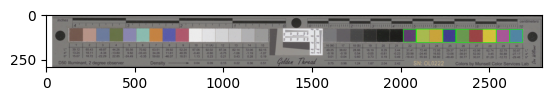

Image: ../images/cropped_scales/fixed\1701224452_scale_only.jpg

Pixels per cm: 115.37132987910189



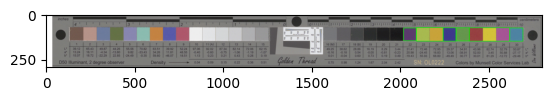

Image: ../images/cropped_scales/fixed\1701224904_scale_only.jpg

Pixels per cm: 115.1986183074266



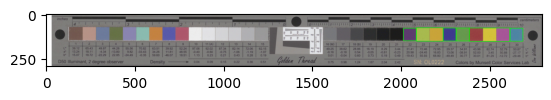

Image: ../images/cropped_scales/fixed\1701225196_scale_only.jpg

Pixels per cm: 115.02590673575129



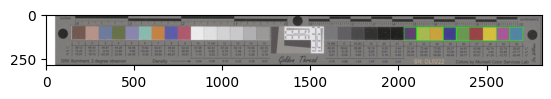

Image: ../images/cropped_scales/fixed\1701225220_scale_only.jpg

Pixels per cm: 115.5440414507772



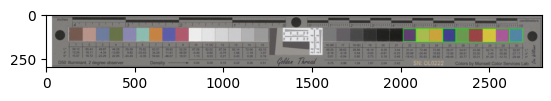

Image: ../images/cropped_scales/fixed\1701225421_a_scale_only.jpg

Pixels per cm: 115.02590673575129



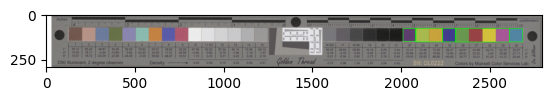

Image: ../images/cropped_scales/fixed\1701225421_b_scale_only.jpg

Pixels per cm: 115.8894645941278



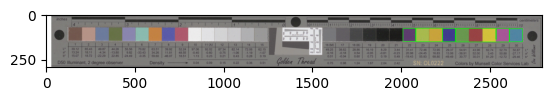

Image: ../images/cropped_scales/fixed\1701225587_a_scale_only.jpg

Pixels per cm: 115.02590673575129



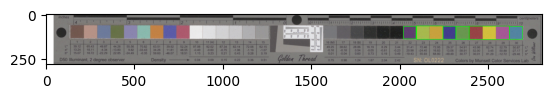

Image: ../images/cropped_scales/fixed\1701225587_b_scale_only.jpg

Pixels per cm: 114.50777202072538



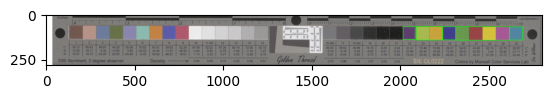

Image: ../images/cropped_scales/fixed\1701227580_scale_only.jpg

Pixels per cm: 115.1986183074266



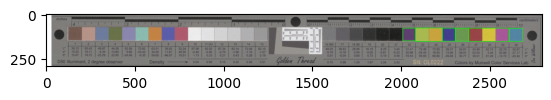

Image: ../images/cropped_scales/fixed\1701227655_scale_only.jpg

Pixels per cm: 115.5440414507772



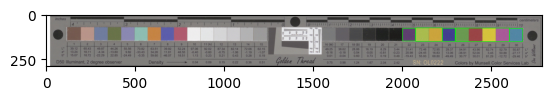

Image: ../images/cropped_scales/fixed\1701227693_scale_only.jpg

Pixels per cm: 118.99827288428325



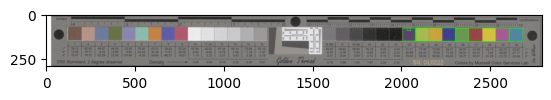

Image: ../images/cropped_scales/fixed\1701227822_scale_only.jpg

Pixels per cm: 114.68048359240069



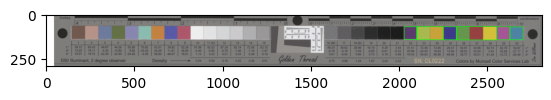

Image: ../images/cropped_scales/fixed\1701227944_scale_only.jpg

Pixels per cm: 114.68048359240069



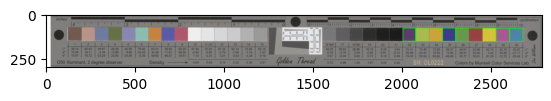

Image: ../images/cropped_scales/fixed\1701228013_scale_only.jpg

Pixels per cm: 115.8894645941278



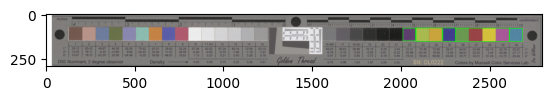

Image: ../images/cropped_scales/fixed\1701228284_scale_only.jpg

Pixels per cm: 114.853195164076



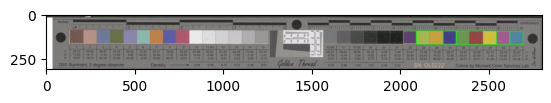

Image: ../images/cropped_scales/fixed\1701228394_scale_only.jpg

Pixels per cm: 115.02590673575129



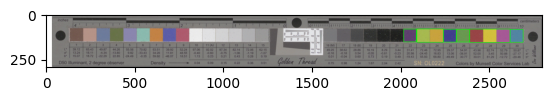

Image: ../images/cropped_scales/fixed\1701228612_scale_only.jpg

Pixels per cm: 115.02590673575129



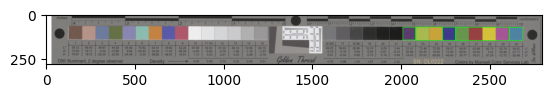

Image: ../images/cropped_scales/fixed\1701229052_scale_only.jpg

Pixels per cm: 116.06217616580311



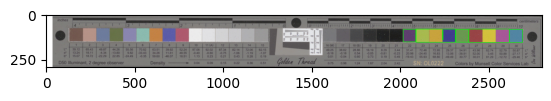

Image: ../images/cropped_scales/fixed\1701229706_scale_only.jpg

Pixels per cm: 114.853195164076



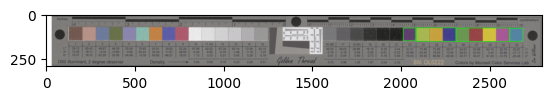

Image: ../images/cropped_scales/fixed\1701229748_scale_only.jpg

Pixels per cm: 113.81692573402418



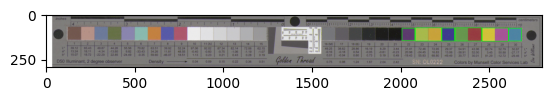

Image: ../images/cropped_scales/fixed\1701231385_scale_only.jpg

Pixels per cm: 118.13471502590673



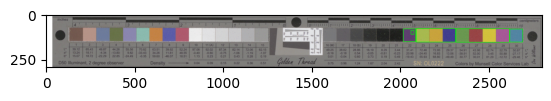

Image: ../images/cropped_scales/fixed\1701232456_scale_only.jpg

Pixels per cm: 114.853195164076



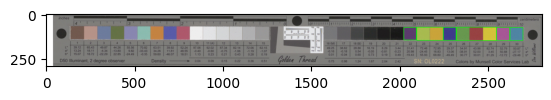

Image: ../images/cropped_scales/fixed\1701233481_scale_only.jpg

Pixels per cm: 115.37132987910189



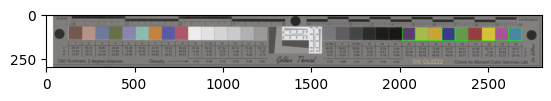

Image: ../images/cropped_scales/fixed\1701236597_scale_only.jpg

Pixels per cm: 114.853195164076



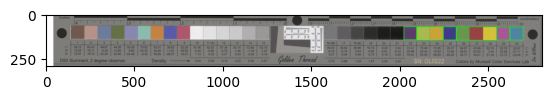

Image: ../images/cropped_scales/fixed\1701236698_scale_only.jpg

Pixels per cm: 114.853195164076



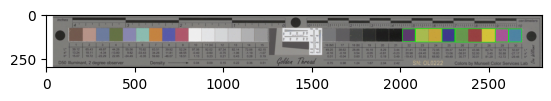

Image: ../images/cropped_scales/fixed\1701236723_scale_only.jpg

Pixels per cm: 115.71675302245251



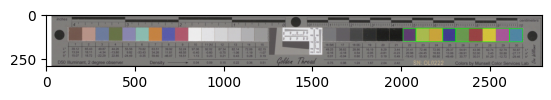

Image: ../images/cropped_scales/fixed\1701236933_scale_only.jpg

Pixels per cm: 115.5440414507772



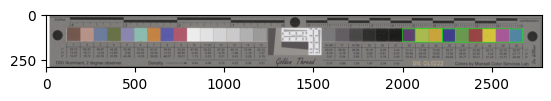

Image: ../images/cropped_scales/fixed\1701237314_scale_only.jpg

Pixels per cm: 115.1986183074266



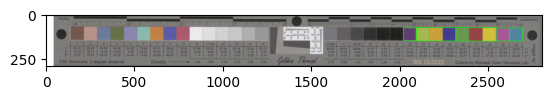

Image: ../images/cropped_scales/fixed\1701238528_scale_only.jpg

Pixels per cm: 118.13471502590673



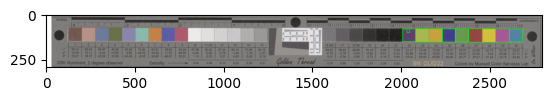

Image: ../images/cropped_scales/fixed\1701239115_scale_only.jpg

Pixels per cm: 118.99827288428325



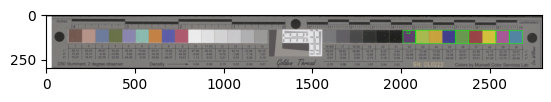

Image: ../images/cropped_scales/fixed\1701239240_scale_only.jpg

Pixels per cm: 115.5440414507772



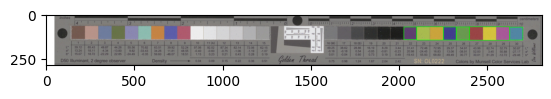

Image: ../images/cropped_scales/fixed\1701239812_scale_only.jpg

Pixels per cm: 114.853195164076



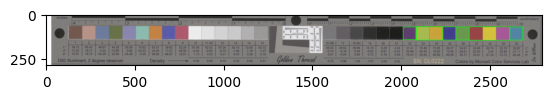

Image: ../images/cropped_scales/fixed\1701240421_scale_only.jpg

Pixels per cm: 114.68048359240069



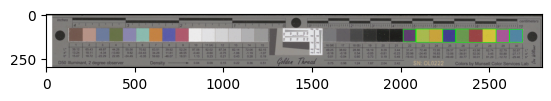

Image: ../images/cropped_scales/fixed\1701240453_scale_only.jpg

Pixels per cm: 115.02590673575129



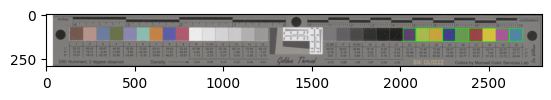

Image: ../images/cropped_scales/fixed\1701241169_scale_only.jpg

Pixels per cm: 118.13471502590673



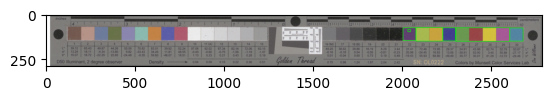

Image: ../images/cropped_scales/fixed\1701241571_scale_only.jpg

Pixels per cm: 114.68048359240069



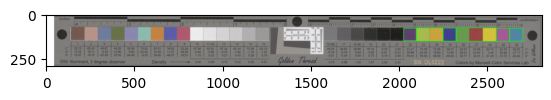

Image: ../images/cropped_scales/fixed\1701241691_scale_only.jpg

Pixels per cm: 119.34369602763385



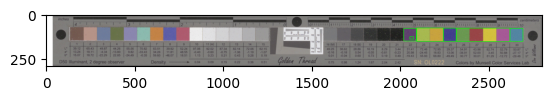

Image: ../images/cropped_scales/fixed\1701241901_scale_only.jpg

Pixels per cm: 118.48013816925734



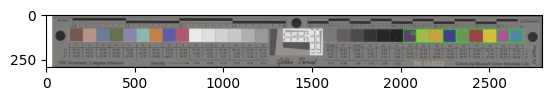

Image: ../images/cropped_scales/fixed\1701242785_scale_only.jpg

Pixels per cm: 115.1986183074266



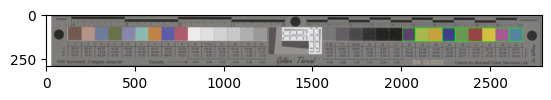

Image: ../images/cropped_scales/fixed\1701243143_scale_only.jpg

Pixels per cm: 115.02590673575129



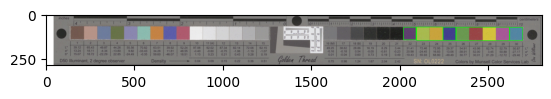

Image: ../images/cropped_scales/fixed\1701244303_scale_only.jpg

Pixels per cm: 115.1986183074266



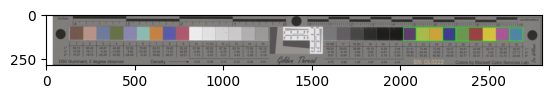

Image: ../images/cropped_scales/fixed\1701244340_scale_only.jpg

Pixels per cm: 115.02590673575129



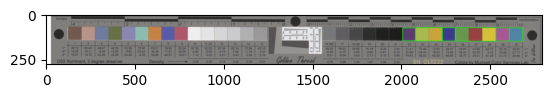

Image: ../images/cropped_scales/fixed\1701244551_scale_only.jpg

Pixels per cm: 114.853195164076



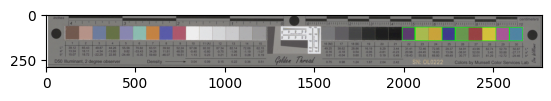

Image: ../images/cropped_scales/fixed\1701245333_scale_only.jpg

Pixels per cm: 116.92573402417962



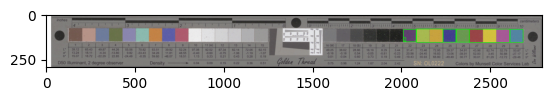

Image: ../images/cropped_scales/fixed\1701246196_a_scale_only.jpg

Pixels per cm: 115.37132987910189



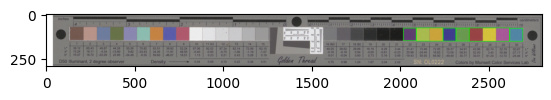

Image: ../images/cropped_scales/fixed\1701246196_b_scale_only.jpg

Pixels per cm: 115.37132987910189



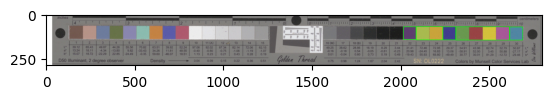

Image: ../images/cropped_scales/fixed\1701246531_scale_only.jpg

Pixels per cm: 119.34369602763385



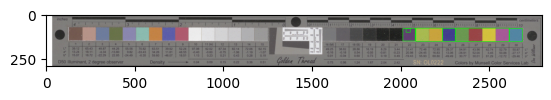

Image: ../images/cropped_scales/fixed\1701247110_scale_only.jpg

Pixels per cm: 121.07081174438687



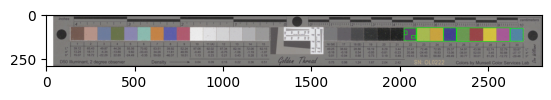

Image: ../images/cropped_scales/fixed\1701247292_scale_only.jpg

Pixels per cm: 115.71675302245251



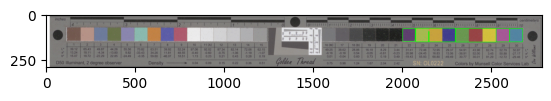

Image: ../images/cropped_scales/fixed\1701247953_scale_only.jpg

Pixels per cm: 115.5440414507772



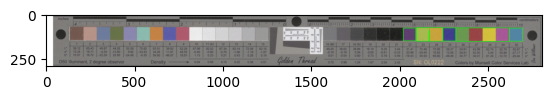

Image: ../images/cropped_scales/fixed\1701248079_scale_only.jpg

Pixels per cm: 115.37132987910189



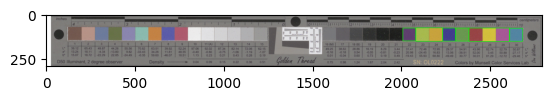

Image: ../images/cropped_scales/fixed\1701248283_scale_only.jpg

Pixels per cm: 115.1986183074266



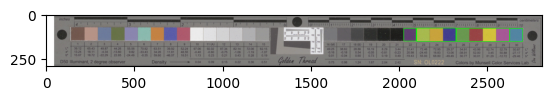

Image: ../images/cropped_scales/fixed\1701248605_scale_only.jpg

Pixels per cm: 115.1986183074266



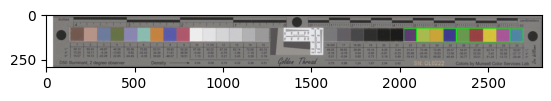

Image: ../images/cropped_scales/fixed\1701248830_scale_only.jpg

Pixels per cm: 114.853195164076



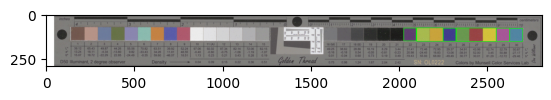

Image: ../images/cropped_scales/fixed\1701249124_scale_only.jpg

Pixels per cm: 115.1986183074266



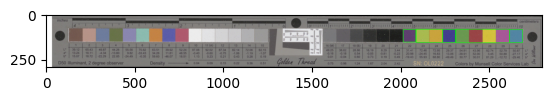

Image: ../images/cropped_scales/fixed\1701250625_scale_only.jpg

Pixels per cm: 114.853195164076



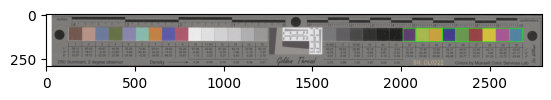

Image: ../images/cropped_scales/fixed\1701252416_scale_only.jpg

Pixels per cm: 115.1986183074266



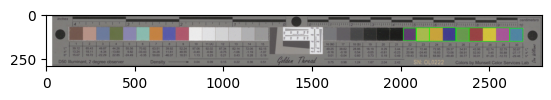

Image: ../images/cropped_scales/fixed\1701252991_scale_only.jpg

Pixels per cm: 115.02590673575129



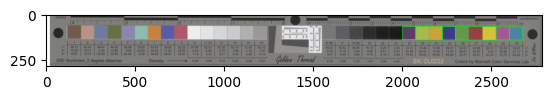

Image: ../images/cropped_scales/fixed\1701253288_scale_only.jpg

Pixels per cm: 118.65284974093264



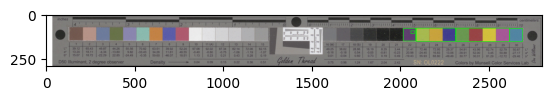

Image: ../images/cropped_scales/fixed\1701253838_scale_only.jpg

Pixels per cm: 118.48013816925734



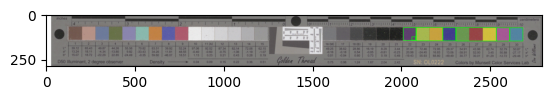

Image: ../images/cropped_scales/fixed\1701254480_scale_only.jpg

Pixels per cm: 119.51640759930915



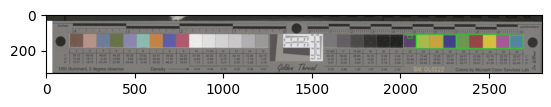

Image: ../images/cropped_scales/fixed\1701254696_scale_only.jpg

Pixels per cm: 116.06217616580311



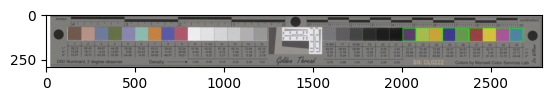

Image: ../images/cropped_scales/fixed\1701256372_scale_only.jpg

Pixels per cm: 115.71675302245251



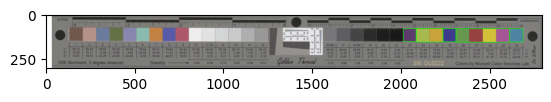

Image: ../images/cropped_scales/fixed\1701257176_scale_only.jpg

Pixels per cm: 120.89810017271157



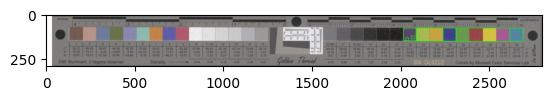

Image: ../images/cropped_scales/fixed\1701258105_scale_only.jpg

Pixels per cm: 120.03454231433506



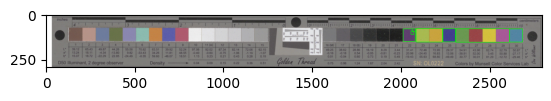

Image: ../images/cropped_scales/fixed\1701258348_scale_only.jpg

Pixels per cm: 115.8894645941278



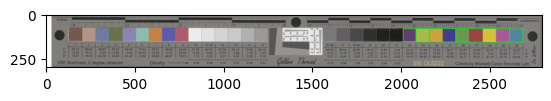

Image: ../images/cropped_scales/fixed\1701258603_scale_only.jpg

Pixels per cm: 102.59067357512953



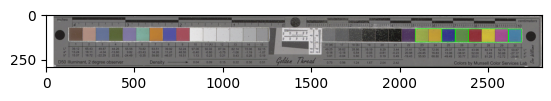

Image: ../images/cropped_scales/fixed\1701258682_scale_only.jpg

Pixels per cm: 103.62694300518135



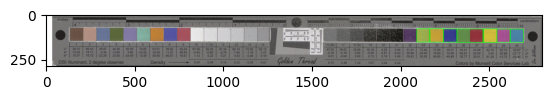

Image: ../images/cropped_scales/fixed\1701259410_scale_only.jpg

Pixels per cm: 115.02590673575129



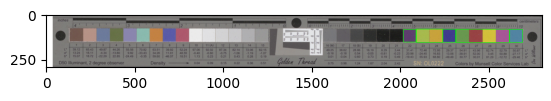

Image: ../images/cropped_scales/fixed\1701259947_scale_only.jpg

Pixels per cm: 115.1986183074266



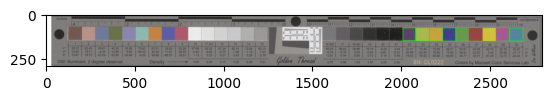

Image: ../images/cropped_scales/fixed\1701260427_scale_only.jpg

Pixels per cm: 115.02590673575129



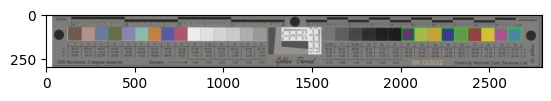

Image: ../images/cropped_scales/fixed\1701260893_scale_only.jpg

Pixels per cm: 115.02590673575129



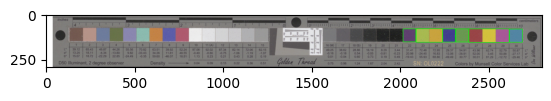

Image: ../images/cropped_scales/fixed\1701260943_scale_only.jpg

Pixels per cm: 115.02590673575129



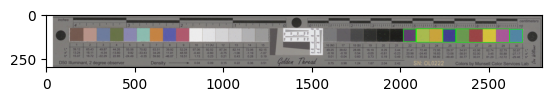

Image: ../images/cropped_scales/fixed\1701260999_scale_only.jpg

Pixels per cm: 117.96200345423144



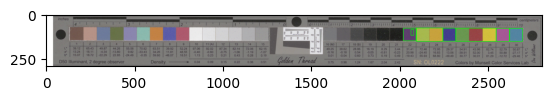

Image: ../images/cropped_scales/fixed\1701262132_scale_only.jpg

Pixels per cm: 115.5440414507772



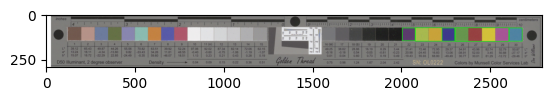

Image: ../images/cropped_scales/fixed\1701262452_scale_only.jpg

Pixels per cm: 114.68048359240069



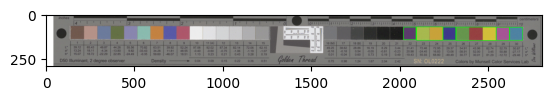

Image: ../images/cropped_scales/fixed\1701264501_scale_only.jpg

Pixels per cm: 114.68048359240069



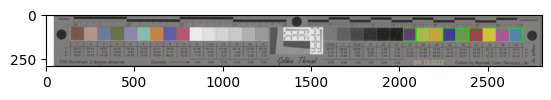

Image: ../images/cropped_scales/fixed\1701264856_scale_only.jpg

Pixels per cm: 116.40759930915371



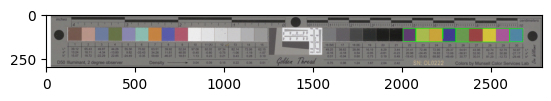

Image: ../images/cropped_scales/fixed\1701265373_scale_only.jpg

Pixels per cm: 115.1986183074266



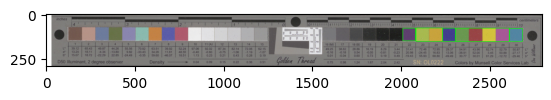

Image: ../images/cropped_scales/fixed\1701266136_scale_only.jpg

Pixels per cm: 117.27115716753022



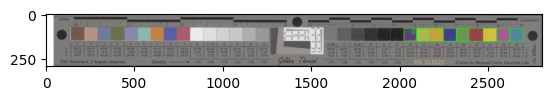

Image: ../images/cropped_scales/fixed\1701266648_scale_only.jpg

Pixels per cm: 118.30742659758204



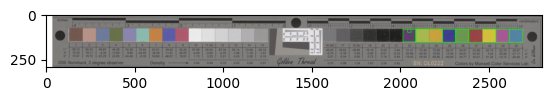

Image: ../images/cropped_scales/fixed\1701267014_scale_only.jpg

Pixels per cm: 115.1986183074266



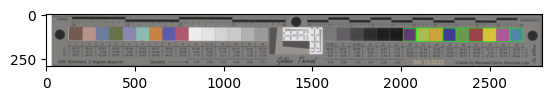

Image: ../images/cropped_scales/fixed\1701267096_scale_only.jpg

Pixels per cm: 115.1986183074266



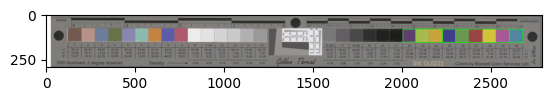

Image: ../images/cropped_scales/fixed\1701267225_scale_only.jpg

Pixels per cm: 115.37132987910189



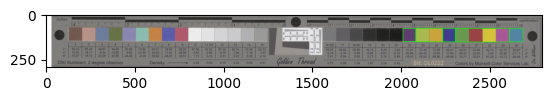

Image: ../images/cropped_scales/fixed\1701268183_scale_only.jpg

Pixels per cm: 115.37132987910189



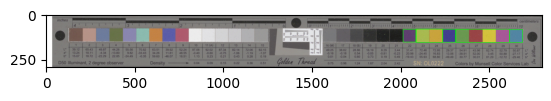

Image: ../images/cropped_scales/fixed\1701268200_scale_only.jpg

Pixels per cm: 115.1986183074266



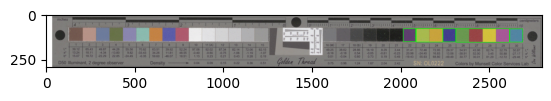

Image: ../images/cropped_scales/fixed\1701268447_scale_only.jpg

Pixels per cm: 115.8894645941278



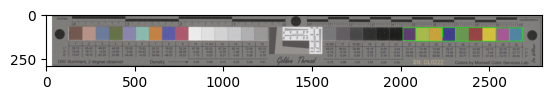

Image: ../images/cropped_scales/fixed\1701268506_scale_only.jpg

Pixels per cm: 115.37132987910189



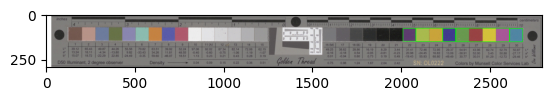

Image: ../images/cropped_scales/fixed\1701268668_scale_only.jpg

Pixels per cm: 115.02590673575129



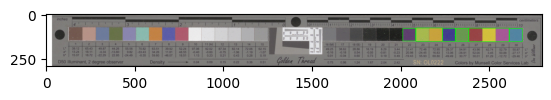

Image: ../images/cropped_scales/fixed\1701268837_scale_only.jpg

Pixels per cm: 115.02590673575129



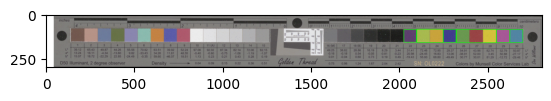

Image: ../images/cropped_scales/fixed\1701269278_a_scale_only.jpg

Pixels per cm: 115.02590673575129



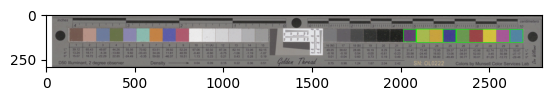

Image: ../images/cropped_scales/fixed\1701269278_b_scale_only.jpg

Pixels per cm: 114.853195164076



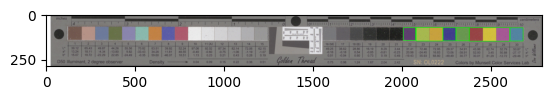

Image: ../images/cropped_scales/fixed\1701269638_scale_only.jpg

Pixels per cm: 115.37132987910189



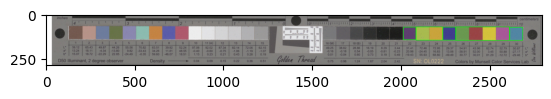

Image: ../images/cropped_scales/fixed\1701269889_scale_only.jpg

Pixels per cm: 117.27115716753022



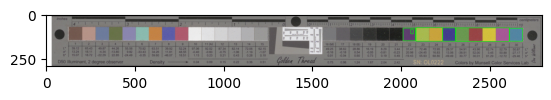

Image: ../images/cropped_scales/fixed\1701270001_scale_only.jpg

Pixels per cm: 115.02590673575129



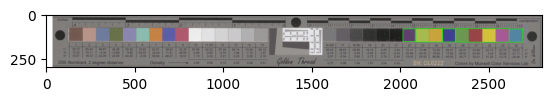

Image: ../images/cropped_scales/fixed\1701270189_scale_only.jpg

Pixels per cm: 115.8894645941278



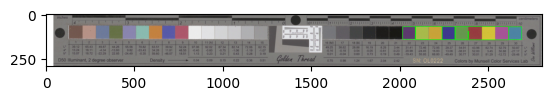

Image: ../images/cropped_scales/fixed\1701270237_scale_only.jpg

Pixels per cm: 114.853195164076



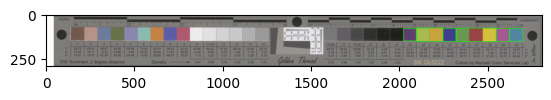

Image: ../images/cropped_scales/fixed\1701270320_a_scale_only.jpg

Pixels per cm: 114.853195164076



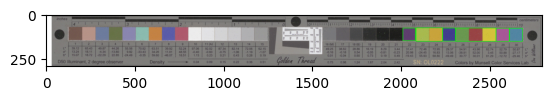

Image: ../images/cropped_scales/fixed\1701270320_b_scale_only.jpg

Pixels per cm: 114.853195164076



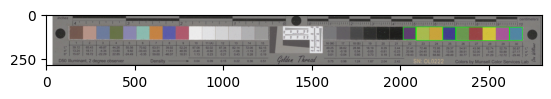

Image: ../images/cropped_scales/fixed\1701270410_scale_only.jpg

Pixels per cm: 104.31778929188256



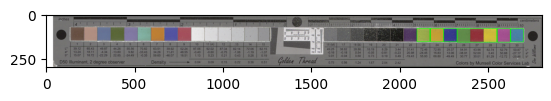

Image: ../images/cropped_scales/fixed\1701271063_scale_only.jpg

Pixels per cm: 115.02590673575129



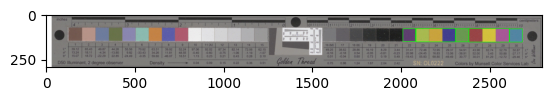

Image: ../images/cropped_scales/fixed\1701271429_scale_only.jpg

Pixels per cm: 115.1986183074266



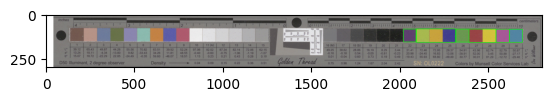

Image: ../images/cropped_scales/fixed\1701271458_scale_only.jpg

Pixels per cm: 117.09844559585493



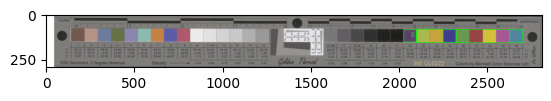

Image: ../images/cropped_scales/fixed\1701271548_scale_only.jpg

Pixels per cm: 115.02590673575129



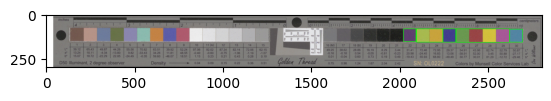

Image: ../images/cropped_scales/fixed\1701271777_scale_only.jpg

Pixels per cm: 115.37132987910189



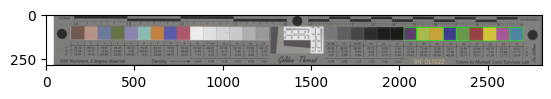

Image: ../images/cropped_scales/fixed\1701272091_scale_only.jpg

Pixels per cm: 103.28151986183074



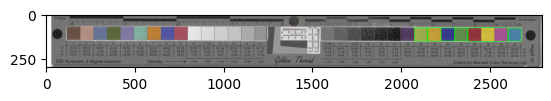

Image: ../images/cropped_scales/fixed\1701272373_scale_only.jpg

Pixels per cm: 115.37132987910189



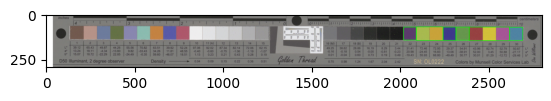

Image: ../images/cropped_scales/fixed\1701273516_scale_only.jpg

Pixels per cm: 114.68048359240069



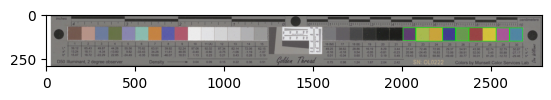

Image: ../images/cropped_scales/fixed\1701274576_scale_only.jpg

Pixels per cm: 115.8894645941278



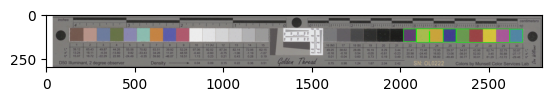

Image: ../images/cropped_scales/fixed\1701275712_a_scale_only.jpg

Pixels per cm: 103.10880829015544



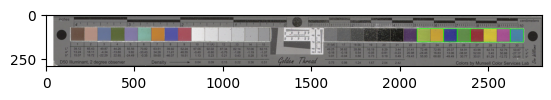

Image: ../images/cropped_scales/fixed\1701275712_b_scale_only.jpg

Pixels per cm: 103.62694300518135



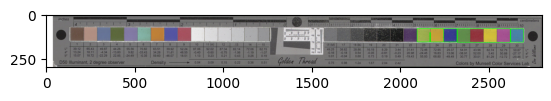

Image: ../images/cropped_scales/fixed\1701275873_scale_only.jpg

Pixels per cm: 115.02590673575129



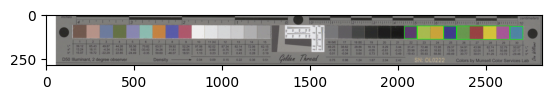

Image: ../images/cropped_scales/fixed\1701275954_scale_only.jpg

Pixels per cm: 115.02590673575129



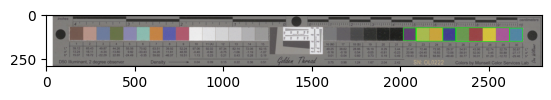

Image: ../images/cropped_scales/fixed\1701276206_scale_only.jpg

Pixels per cm: 115.8894645941278



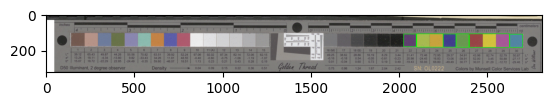

Image: ../images/cropped_scales/fixed\1701276562_scale_only.jpg

Pixels per cm: 118.99827288428325



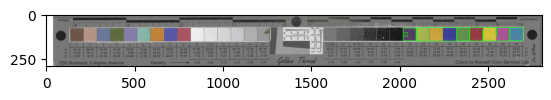

Image: ../images/cropped_scales/fixed\1701276850_scale_only.jpg

Pixels per cm: 114.853195164076



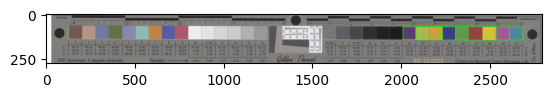

Image: ../images/cropped_scales/fixed\1701277520_scale_only.jpg

Pixels per cm: 115.37132987910189



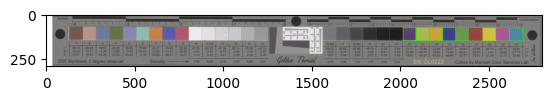

Image: ../images/cropped_scales/fixed\1701277717_scale_only.jpg

Pixels per cm: 114.853195164076



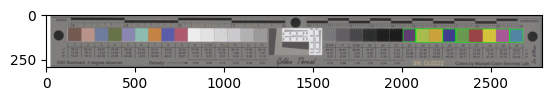

Image: ../images/cropped_scales/fixed\1701278276_scale_only.jpg

Pixels per cm: 115.37132987910189



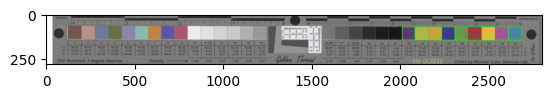

Image: ../images/cropped_scales/fixed\1701278401_scale_only.jpg

Pixels per cm: 117.96200345423144



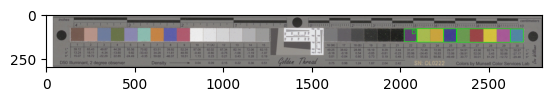

Image: ../images/cropped_scales/fixed\1701278482_scale_only.jpg

Pixels per cm: 115.1986183074266



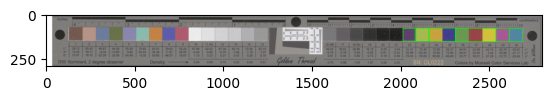

Image: ../images/cropped_scales/fixed\1701278511_scale_only.jpg

Pixels per cm: 114.68048359240069



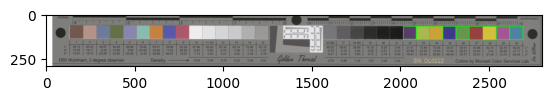

Image: ../images/cropped_scales/fixed\1701278591_a_scale_only.jpg

Pixels per cm: 118.65284974093264



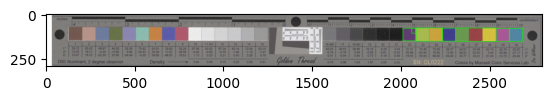

Image: ../images/cropped_scales/fixed\1701278591_b_scale_only.jpg

Pixels per cm: 115.02590673575129



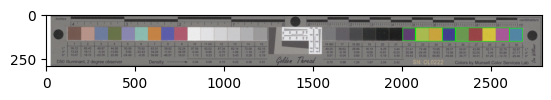

Image: ../images/cropped_scales/fixed\1701279369_a_scale_only.jpg

Pixels per cm: 115.5440414507772



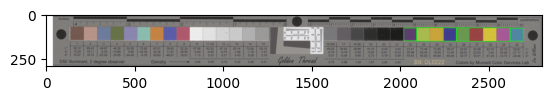

Image: ../images/cropped_scales/fixed\1701279369_b_scale_only.jpg

Pixels per cm: 114.853195164076



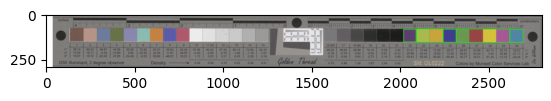

Image: ../images/cropped_scales/fixed\1701279369_c_scale_only.jpg

Pixels per cm: 115.1986183074266



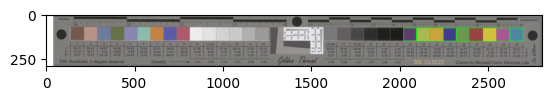

Image: ../images/cropped_scales/fixed\1701279694_scale_only.jpg

Pixels per cm: 115.37132987910189



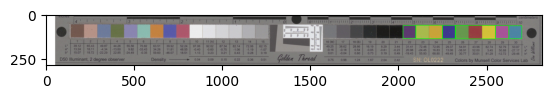

Image: ../images/cropped_scales/fixed\1701280461_scale_only.jpg

Pixels per cm: 115.02590673575129



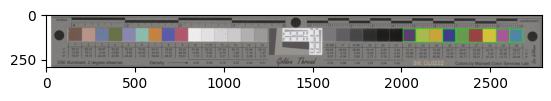

Image: ../images/cropped_scales/fixed\1701280473_scale_only.jpg

Pixels per cm: 115.37132987910189



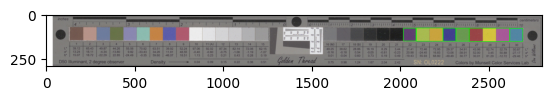

Image: ../images/cropped_scales/fixed\1701280495_scale_only.jpg

Pixels per cm: 118.13471502590673



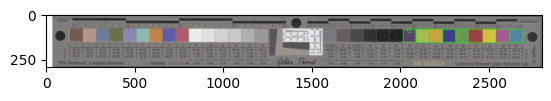

Image: ../images/cropped_scales/fixed\1701281477_scale_only.jpg

Pixels per cm: 115.1986183074266



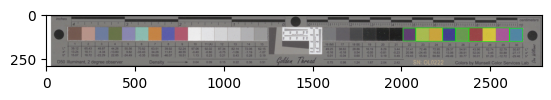

Image: ../images/cropped_scales/fixed\1701282364_scale_only.jpg

Pixels per cm: 115.37132987910189



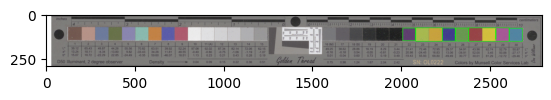

Image: ../images/cropped_scales/fixed\1701283882_scale_only.jpg

Pixels per cm: 115.1986183074266



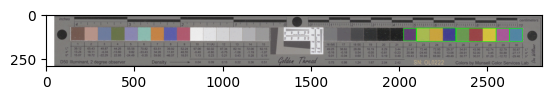

Image: ../images/cropped_scales/fixed\1701284653_scale_only.jpg

Pixels per cm: 115.02590673575129



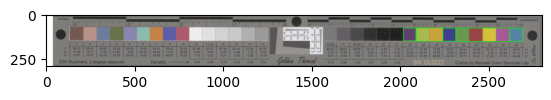

Image: ../images/cropped_scales/fixed\1701284737_scale_only.jpg

Pixels per cm: 115.02590673575129



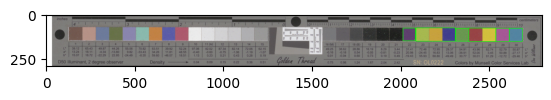

Image: ../images/cropped_scales/fixed\1701285359_scale_only.jpg

Pixels per cm: 115.1986183074266



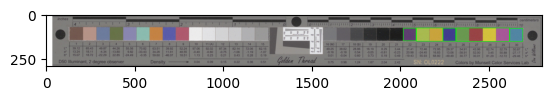

Image: ../images/cropped_scales/fixed\1701285720_scale_only.jpg

Pixels per cm: 115.1986183074266



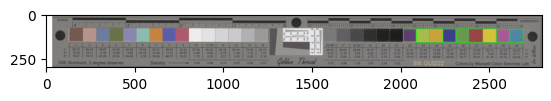

Image: ../images/cropped_scales/fixed\1701286266_scale_only.jpg

Pixels per cm: 115.37132987910189



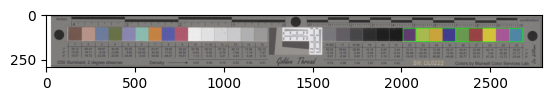

Image: ../images/cropped_scales/fixed\1701286825_scale_only.jpg

Pixels per cm: 114.853195164076



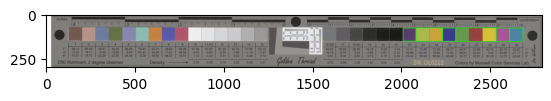

Image: ../images/cropped_scales/fixed\1701287203_scale_only.jpg

Pixels per cm: 115.5440414507772



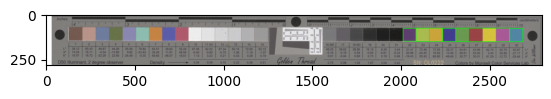

Image: ../images/cropped_scales/fixed\1701287499_scale_only.jpg

Pixels per cm: 115.5440414507772



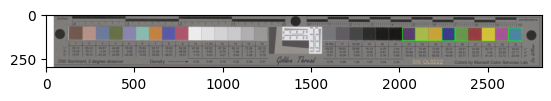

Image: ../images/cropped_scales/fixed\1701287515_scale_only.jpg

Pixels per cm: 115.1986183074266



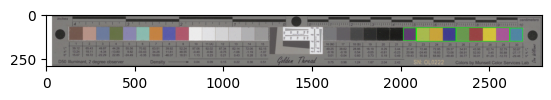

Image: ../images/cropped_scales/fixed\1701287774_scale_only.jpg

Pixels per cm: 115.1986183074266



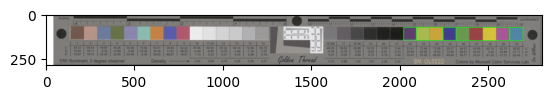

Image: ../images/cropped_scales/fixed\1701288116_scale_only.jpg

Pixels per cm: 115.02590673575129



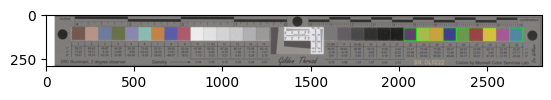

Image: ../images/cropped_scales/fixed\1701288382_scale_only.jpg

Pixels per cm: 115.1986183074266



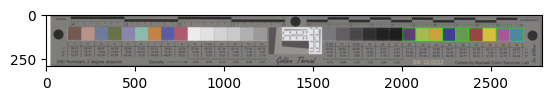

Image: ../images/cropped_scales/fixed\1701288394_scale_only.jpg

Pixels per cm: 115.8894645941278



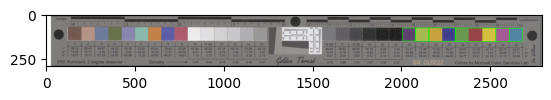

Image: ../images/cropped_scales/fixed\1701288403_scale_only.jpg

Pixels per cm: 118.99827288428325



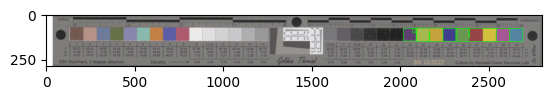

Image: ../images/cropped_scales/fixed\1701288407_scale_only.jpg

Pixels per cm: 115.37132987910189



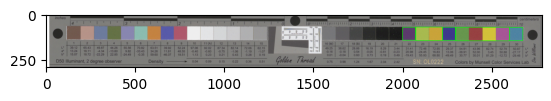

Image: ../images/cropped_scales/fixed\1701288485_scale_only.jpg

Pixels per cm: 115.1986183074266



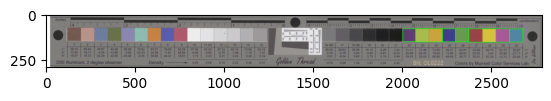

Image: ../images/cropped_scales/fixed\1701288571_a_scale_only.jpg

Pixels per cm: 123.3160621761658



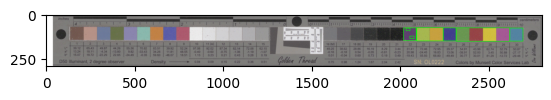

Image: ../images/cropped_scales/fixed\1701288571_b_scale_only.jpg

Pixels per cm: 114.853195164076



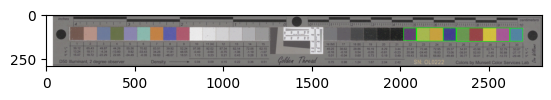

Image: ../images/cropped_scales/fixed\1701288571_c_scale_only.jpg

Pixels per cm: 117.96200345423144



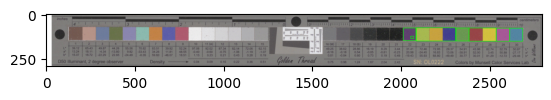

Image: ../images/cropped_scales/fixed\1701288668_scale_only.jpg

Pixels per cm: 115.02590673575129



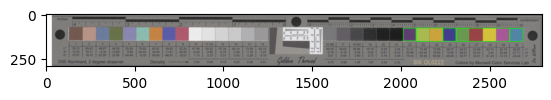

Image: ../images/cropped_scales/fixed\1701288731_scale_only.jpg

Pixels per cm: 115.5440414507772



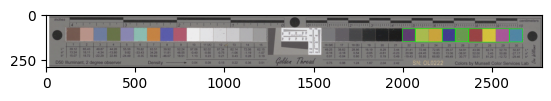

Image: ../images/cropped_scales/fixed\1701288734_a_scale_only.jpg

Pixels per cm: 115.5440414507772



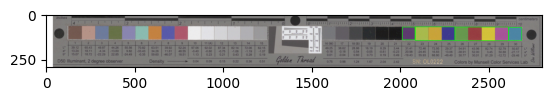

Image: ../images/cropped_scales/fixed\1701288734_b_scale_only.jpg

Pixels per cm: 115.71675302245251



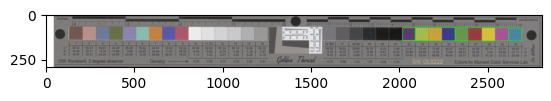

Image: ../images/cropped_scales/fixed\1701288737_scale_only.jpg

Pixels per cm: 115.5440414507772



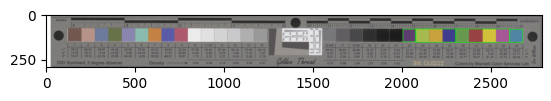

Image: ../images/cropped_scales/fixed\1701288755_scale_only.jpg

Pixels per cm: 115.37132987910189



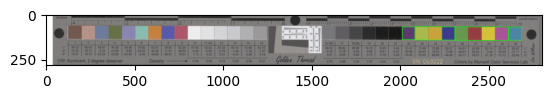

Image: ../images/cropped_scales/fixed\1701288790_scale_only.jpg

Pixels per cm: 114.68048359240069



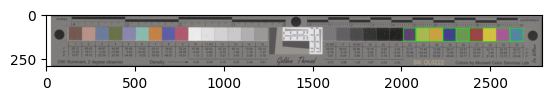

Image: ../images/cropped_scales/fixed\1701288797_scale_only.jpg

Pixels per cm: 115.37132987910189



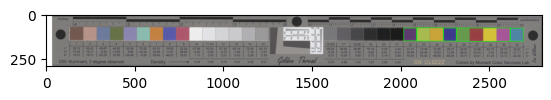

Image: ../images/cropped_scales/fixed\1701288806_scale_only.jpg

Pixels per cm: 115.37132987910189



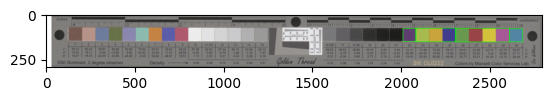

Image: ../images/cropped_scales/fixed\1701288830_scale_only.jpg

Pixels per cm: 114.853195164076



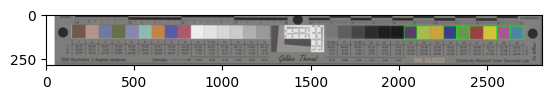

Image: ../images/cropped_scales/fixed\1701288838_scale_only.jpg

Pixels per cm: 115.1986183074266



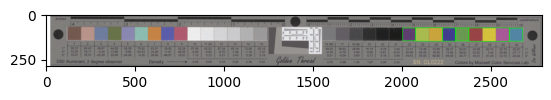

Image: ../images/cropped_scales/fixed\1701288849_scale_only.jpg

Pixels per cm: 115.02590673575129



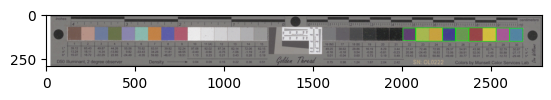

Image: ../images/cropped_scales/fixed\1701288889_a_scale_only.jpg

Pixels per cm: 114.33506044905009



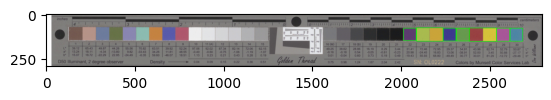

Image: ../images/cropped_scales/fixed\1701288889_b_scale_only.jpg

Pixels per cm: 115.02590673575129



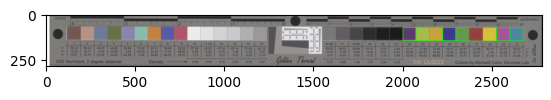

Image: ../images/cropped_scales/fixed\1701288892_scale_only.jpg

Pixels per cm: 115.5440414507772



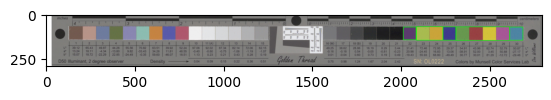

Image: ../images/cropped_scales/fixed\1701289118_scale_only.jpg

Pixels per cm: 115.5440414507772



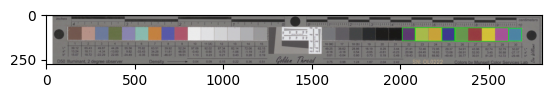

Image: ../images/cropped_scales/fixed\1701289339_scale_only.jpg

Pixels per cm: 116.06217616580311



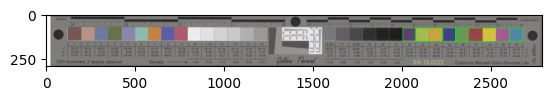

Image: ../images/cropped_scales/fixed\1701289386_scale_only.jpg

Pixels per cm: 116.06217616580311



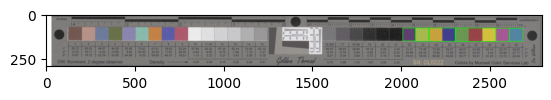

Image: ../images/cropped_scales/fixed\1701289415_scale_only.jpg

Pixels per cm: 115.37132987910189



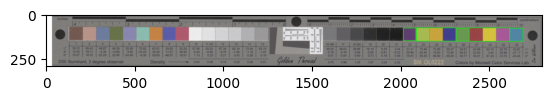

Image: ../images/cropped_scales/fixed\1701289974_a_scale_only.jpg

Pixels per cm: 115.02590673575129



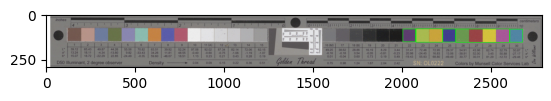

Image: ../images/cropped_scales/fixed\1701289974_b_scale_only.jpg

Pixels per cm: 116.06217616580311



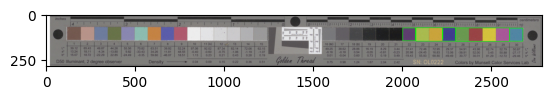

Image: ../images/cropped_scales/fixed\1701291011_scale_only.jpg

Pixels per cm: 116.06217616580311



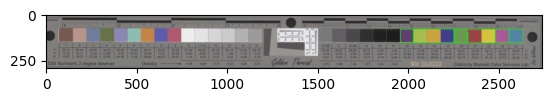

Image: ../images/cropped_scales/fixed\1701291014_a_scale_only.jpg

Pixels per cm: 117.96200345423144



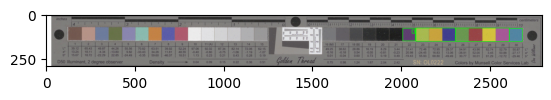

Image: ../images/cropped_scales/fixed\1701291071_scale_only.jpg

Pixels per cm: 115.02590673575129



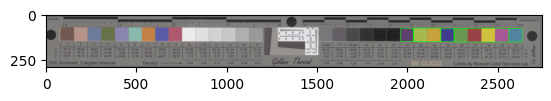

Image: ../images/cropped_scales/fixed\1701291477_scale_only.jpg

Pixels per cm: 114.50777202072538



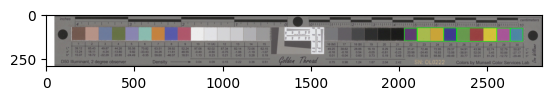

Image: ../images/cropped_scales/fixed\1701292203_scale_only.jpg

Pixels per cm: 114.68048359240069



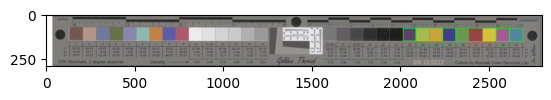

Image: ../images/cropped_scales/fixed\1701292969_scale_only.jpg

Pixels per cm: 115.37132987910189



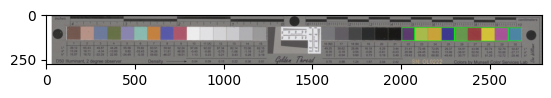

Image: ../images/cropped_scales/fixed\1701293009_scale_only.jpg

Pixels per cm: 115.8894645941278



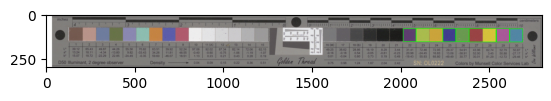

Image: ../images/cropped_scales/fixed\1701293687_scale_only.jpg

Pixels per cm: 115.5440414507772



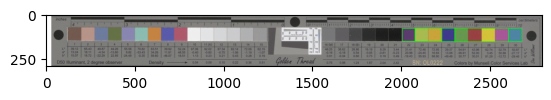

Image: ../images/cropped_scales/fixed\1701293981_scale_only.jpg

Pixels per cm: 114.853195164076



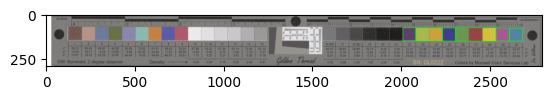

Image: ../images/cropped_scales/fixed\1701294979_scale_only.jpg

Pixels per cm: 118.48013816925734



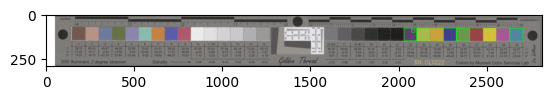

Image: ../images/cropped_scales/fixed\1701295164_scale_only.jpg

Pixels per cm: 114.68048359240069



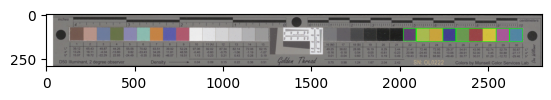

Image: ../images/cropped_scales/fixed\1701295486_a_scale_only.jpg

Pixels per cm: 114.853195164076



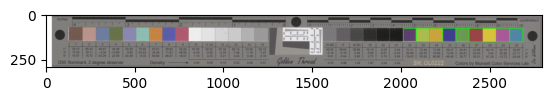

Image: ../images/cropped_scales/fixed\1701295486_b_scale_only.jpg

Pixels per cm: 115.1986183074266



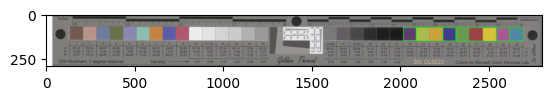

Image: ../images/cropped_scales/fixed\1701295965_scale_only.jpg

Pixels per cm: 115.1986183074266



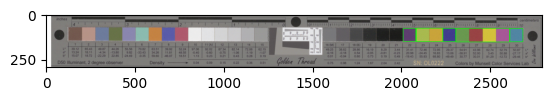

Image: ../images/cropped_scales/fixed\1701296326_scale_only.jpg

Pixels per cm: 115.02590673575129



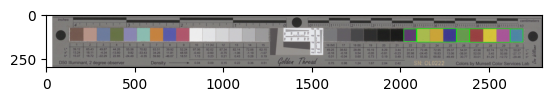

Image: ../images/cropped_scales/fixed\1701296679_scale_only.jpg

Pixels per cm: 115.02590673575129



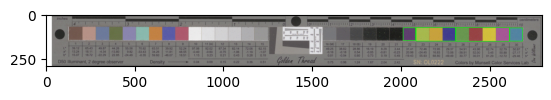

Image: ../images/cropped_scales/fixed\1701296892_scale_only.jpg

Pixels per cm: 115.1986183074266



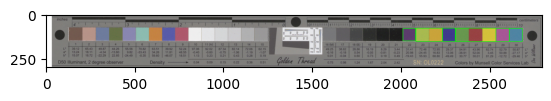

Image: ../images/cropped_scales/fixed\1701296927_scale_only.jpg

Pixels per cm: 114.50777202072538



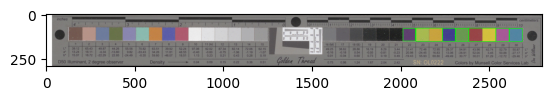

Image: ../images/cropped_scales/fixed\1701297375_scale_only.jpg

Pixels per cm: 115.1986183074266



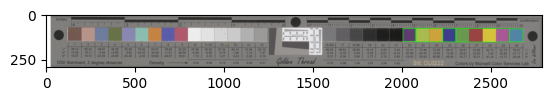

Image: ../images/cropped_scales/fixed\1701298025_scale_only.jpg

Pixels per cm: 115.71675302245251



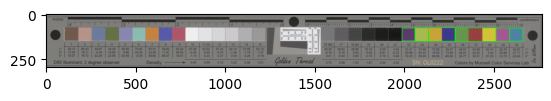

Image: ../images/cropped_scales/fixed\1701298325_scale_only.jpg

Pixels per cm: 114.853195164076



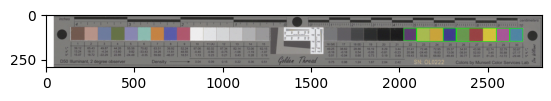

Image: ../images/cropped_scales/fixed\1701298361_scale_only.jpg

Pixels per cm: 115.5440414507772



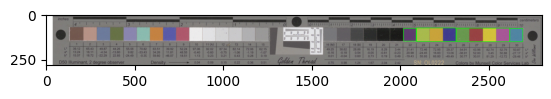

Image: ../images/cropped_scales/fixed\1701299020_scale_only.jpg

Pixels per cm: 115.1986183074266



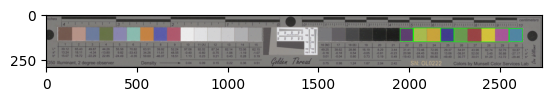

Image: ../images/cropped_scales/fixed\1701299449_scale_only.jpg

Pixels per cm: 115.02590673575129



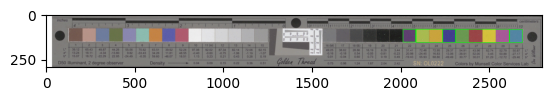

Image: ../images/cropped_scales/fixed\1701299943_scale_only.jpg

Pixels per cm: 122.6252158894646



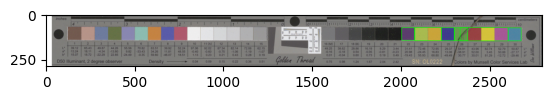

Image: ../images/cropped_scales/fixed\1701301004_scale_only.jpg

Pixels per cm: 115.37132987910189



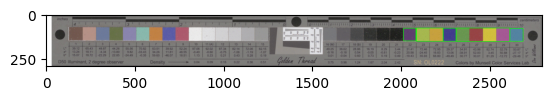

Image: ../images/cropped_scales/fixed\1701301102_scale_only.jpg

Pixels per cm: 115.02590673575129



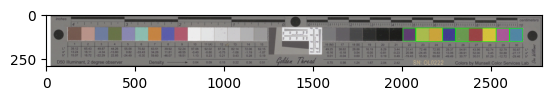

Image: ../images/cropped_scales/fixed\1701301197_scale_only.jpg

Pixels per cm: 117.44386873920553



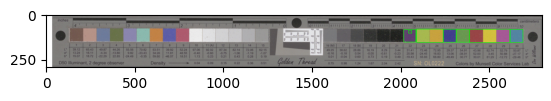

Image: ../images/cropped_scales/fixed\1701301388_scale_only.jpg

Pixels per cm: 115.02590673575129



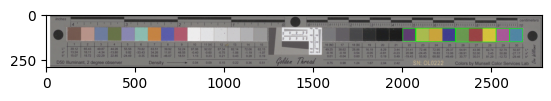

Image: ../images/cropped_scales/fixed\1701301407_scale_only.jpg

Pixels per cm: 114.853195164076



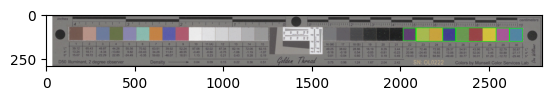

Image: ../images/cropped_scales/fixed\1701301441_scale_only.jpg

Pixels per cm: 122.79792746113989



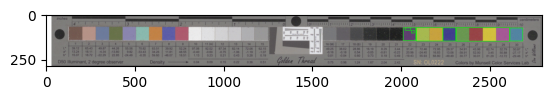

Image: ../images/cropped_scales/fixed\1701301604_scale_only.jpg

Pixels per cm: 115.37132987910189



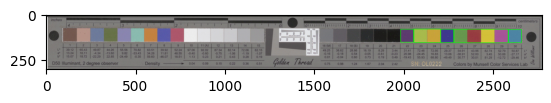

Image: ../images/cropped_scales/fixed\1701301783_scale_only.jpg

Pixels per cm: 114.853195164076



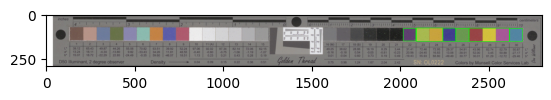

Image: ../images/cropped_scales/fixed\1701301855_scale_only.jpg

Pixels per cm: 114.853195164076



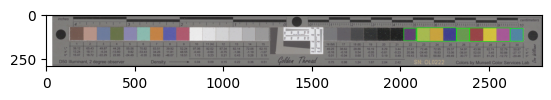

Image: ../images/cropped_scales/fixed\1701301885_scale_only.jpg

Pixels per cm: 115.8894645941278



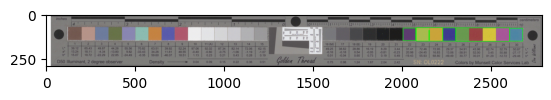

Image: ../images/cropped_scales/fixed\1701303041_scale_only.jpg

Pixels per cm: 115.02590673575129



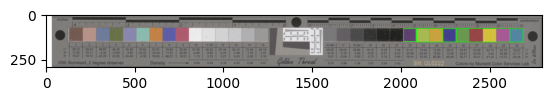

Image: ../images/cropped_scales/fixed\1701303060_scale_only.jpg

Pixels per cm: 115.71675302245251



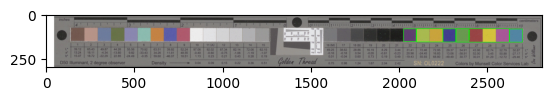

Image: ../images/cropped_scales/fixed\1701303177_scale_only.jpg

Pixels per cm: 115.37132987910189



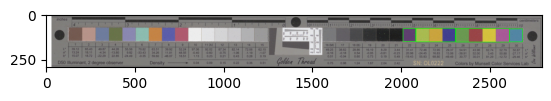

Image: ../images/cropped_scales/fixed\1701303671_scale_only.jpg

Pixels per cm: 115.71675302245251



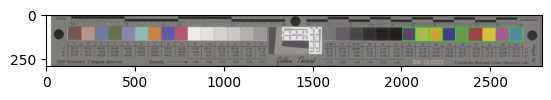

Image: ../images/cropped_scales/fixed\1701303884_scale_only.jpg

Pixels per cm: 115.02590673575129



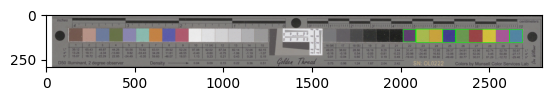

Image: ../images/cropped_scales/fixed\1701303994_scale_only.jpg

Pixels per cm: 114.853195164076



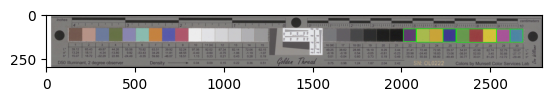

Image: ../images/cropped_scales/fixed\1701304079_scale_only.jpg

Pixels per cm: 119.17098445595855



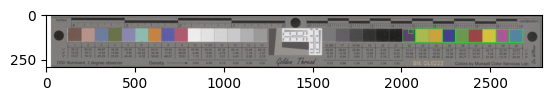

Image: ../images/cropped_scales/fixed\1701304283_scale_only.jpg

Pixels per cm: 115.02590673575129



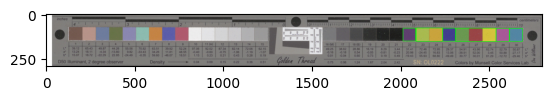

Image: ../images/cropped_scales/fixed\1701304823_scale_only.jpg

Pixels per cm: 115.37132987910189



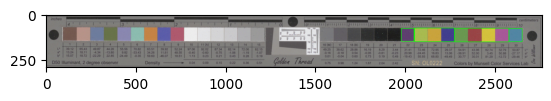

Image: ../images/cropped_scales/fixed\1701305434_scale_only.jpg

Pixels per cm: 114.853195164076



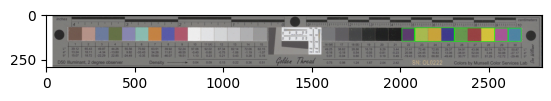

Image: ../images/cropped_scales/fixed\1701305651_scale_only.jpg

Pixels per cm: 115.8894645941278



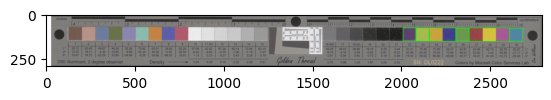

Image: ../images/cropped_scales/fixed\1701306198_scale_only.jpg

Pixels per cm: 115.71675302245251



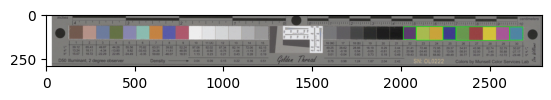

Image: ../images/cropped_scales/fixed\1701306246_scale_only.jpg

Pixels per cm: 115.37132987910189



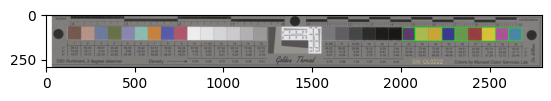

Image: ../images/cropped_scales/fixed\1701307200_scale_only.jpg

Pixels per cm: 116.40759930915371



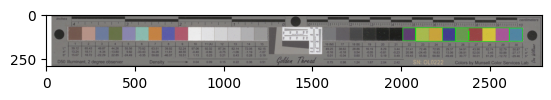

Image: ../images/cropped_scales/fixed\1701307951_scale_only.jpg

Pixels per cm: 115.37132987910189



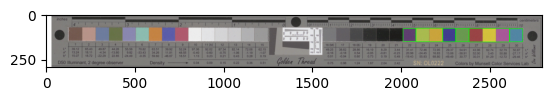

Image: ../images/cropped_scales/fixed\1701307973_scale_only.jpg

Pixels per cm: 115.37132987910189



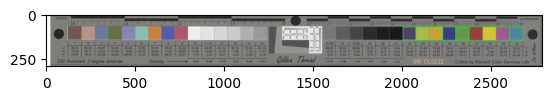

Image: ../images/cropped_scales/fixed\1701308012_scale_only.jpg

Pixels per cm: 117.78929188255613



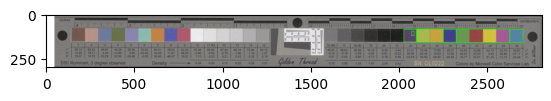

Image: ../images/cropped_scales/fixed\1701308248_scale_only.jpg

Pixels per cm: 114.853195164076



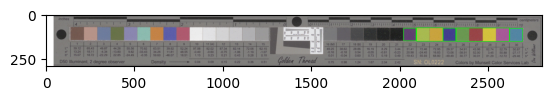

Image: ../images/cropped_scales/fixed\1701308269_scale_only.jpg

Pixels per cm: 118.13471502590673



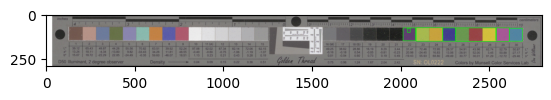

Image: ../images/cropped_scales/fixed\1701308838_scale_only.jpg

Pixels per cm: 115.02590673575129



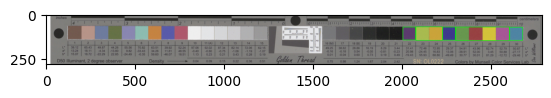

Image: ../images/cropped_scales/fixed\1701309480_scale_only.jpg

Pixels per cm: 115.02590673575129



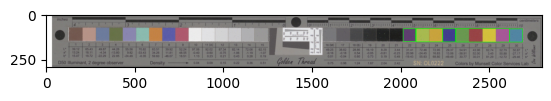

Image: ../images/cropped_scales/fixed\1701309802_scale_only.jpg

Pixels per cm: 115.71675302245251



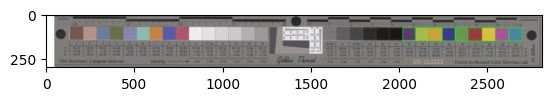

Image: ../images/cropped_scales/fixed\1701310316_scale_only.jpg

Pixels per cm: 115.5440414507772



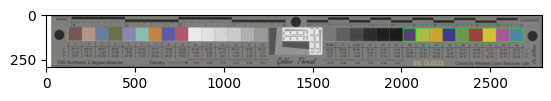

Image: ../images/cropped_scales/fixed\1701311095_scale_only.jpg

Pixels per cm: 114.853195164076



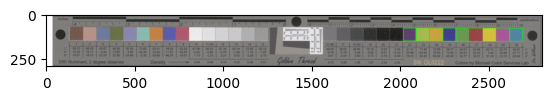

Image: ../images/cropped_scales/fixed\1701311180_scale_only.jpg

Pixels per cm: 114.68048359240069



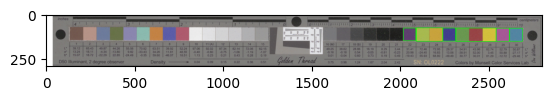

Image: ../images/cropped_scales/fixed\1701311344_scale_only.jpg

Pixels per cm: 115.37132987910189



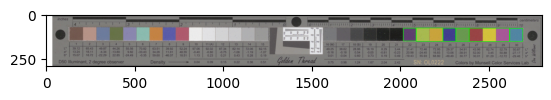

Image: ../images/cropped_scales/fixed\1701311789_scale_only.jpg

Pixels per cm: 115.02590673575129



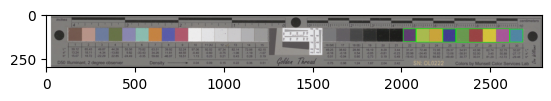

Image: ../images/cropped_scales/fixed\1701312368_scale_only.jpg

Pixels per cm: 115.02590673575129



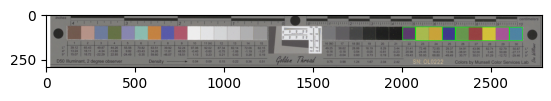

Image: ../images/cropped_scales/fixed\1701312876_scale_only.jpg

Pixels per cm: 114.853195164076



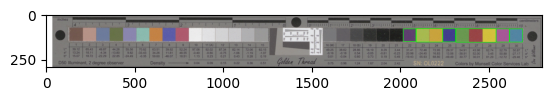

Image: ../images/cropped_scales/fixed\1701312916_scale_only.jpg

Pixels per cm: 115.71675302245251



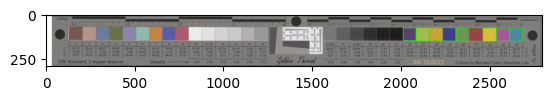

Image: ../images/cropped_scales/fixed\1701313986_scale_only.jpg

Pixels per cm: 115.02590673575129



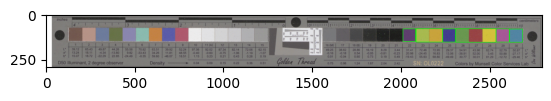

Image: ../images/cropped_scales/fixed\1701314493_scale_only.jpg

Pixels per cm: 115.5440414507772



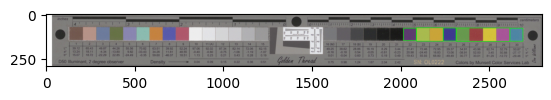

Image: ../images/cropped_scales/fixed\1701314935_scale_only.jpg

Pixels per cm: 115.02590673575129



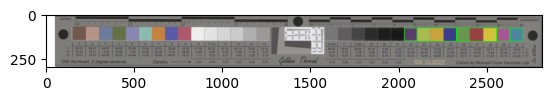

Image: ../images/cropped_scales/fixed\1701315142_scale_only.jpg

Pixels per cm: 115.37132987910189



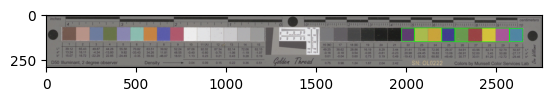

Image: ../images/cropped_scales/fixed\1701315306_scale_only.jpg

Pixels per cm: 115.1986183074266



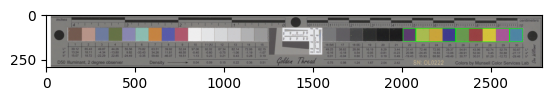

Image: ../images/cropped_scales/fixed\1701315556_scale_only.jpg

Pixels per cm: 115.1986183074266



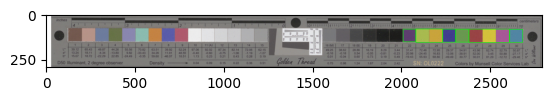

Image: ../images/cropped_scales/fixed\1701316898_scale_only.jpg

Pixels per cm: 114.68048359240069



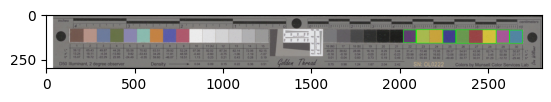

Image: ../images/cropped_scales/fixed\1701316980_scale_only.jpg

Pixels per cm: 115.1986183074266



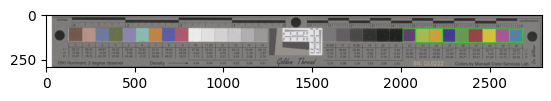

Image: ../images/cropped_scales/fixed\1701317925_scale_only.jpg

Pixels per cm: 115.1986183074266



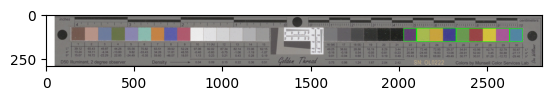

Image: ../images/cropped_scales/fixed\1701318436_scale_only.jpg

Pixels per cm: 115.5440414507772



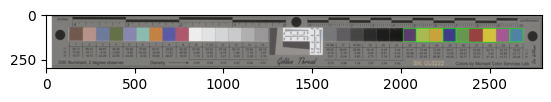

Image: ../images/cropped_scales/fixed\1701318978_scale_only.jpg

Pixels per cm: 114.68048359240069



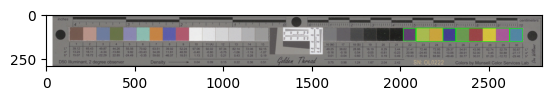

Image: ../images/cropped_scales/fixed\1701319446_scale_only.jpg

Pixels per cm: 115.71675302245251



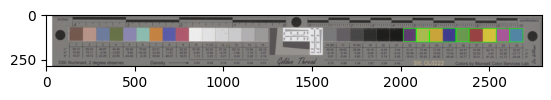

Image: ../images/cropped_scales/fixed\1701320487_scale_only.jpg

Pixels per cm: 115.5440414507772



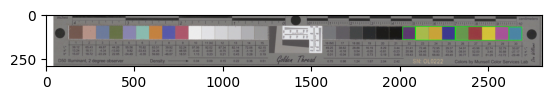

Image: ../images/cropped_scales/fixed\1701321103_scale_only.jpg

Pixels per cm: 115.8894645941278



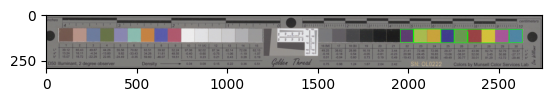

Image: ../images/cropped_scales/fixed\1701321539_scale_only.jpg

Pixels per cm: 115.02590673575129



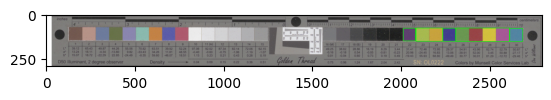

Image: ../images/cropped_scales/fixed\1701321662_scale_only.jpg

Pixels per cm: 114.50777202072538



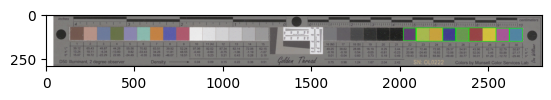

Image: ../images/cropped_scales/fixed\1701322166_scale_only.jpg

Pixels per cm: 117.78929188255613



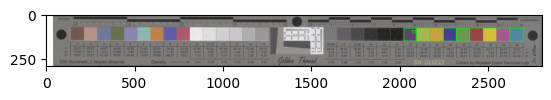

Image: ../images/cropped_scales/fixed\1701322310_scale_only.jpg

Pixels per cm: 102.93609671848014



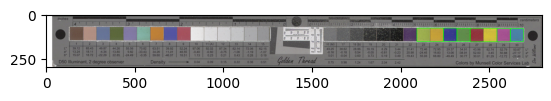

Image: ../images/cropped_scales/fixed\1701323001_scale_only.jpg

Pixels per cm: 115.37132987910189



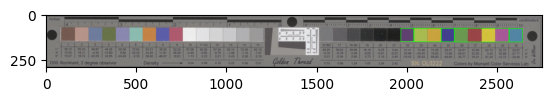

Image: ../images/cropped_scales/fixed\1701324530_scale_only.jpg

Pixels per cm: 115.5440414507772



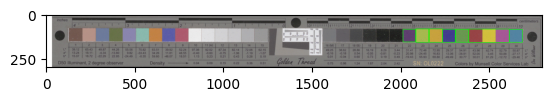

Image: ../images/cropped_scales/fixed\1701324575_scale_only.jpg

Pixels per cm: 115.37132987910189



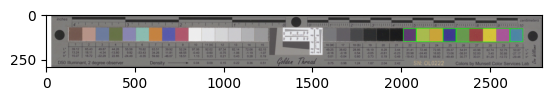

Image: ../images/cropped_scales/fixed\1701324626_scale_only.jpg

Pixels per cm: 115.5440414507772



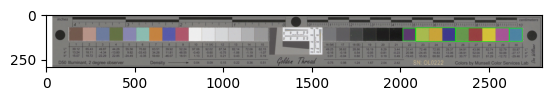

Image: ../images/cropped_scales/fixed\1701324984_scale_only.jpg

Pixels per cm: 114.853195164076



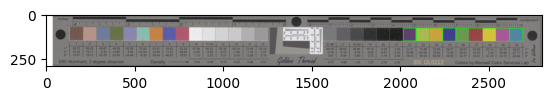

Image: ../images/cropped_scales/fixed\1701325229_scale_only.jpg

Pixels per cm: 115.1986183074266



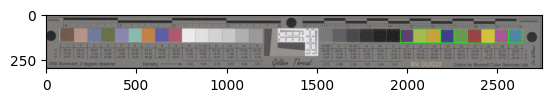

Image: ../images/cropped_scales/fixed\1701325603_scale_only.jpg

Pixels per cm: 115.1986183074266



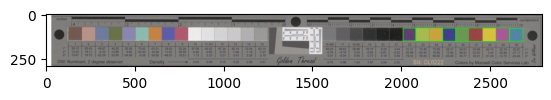

Image: ../images/cropped_scales/fixed\1701325852_scale_only.jpg

Pixels per cm: 114.853195164076



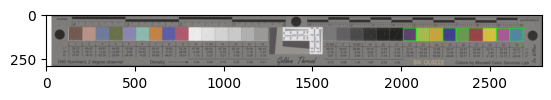

Image: ../images/cropped_scales/fixed\1701325993_scale_only.jpg

Pixels per cm: 119.34369602763385



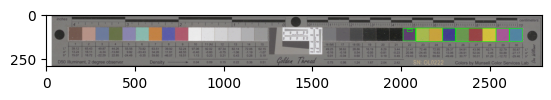

Image: ../images/cropped_scales/fixed\1701326048_scale_only.jpg

Pixels per cm: 114.68048359240069



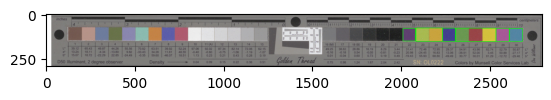

Image: ../images/cropped_scales/fixed\1701326626_scale_only.jpg

Pixels per cm: 115.37132987910189



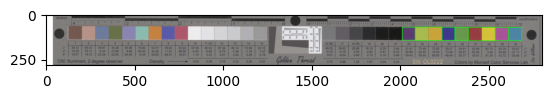

Image: ../images/cropped_scales/fixed\1701327093_scale_only.jpg

Pixels per cm: 115.02590673575129



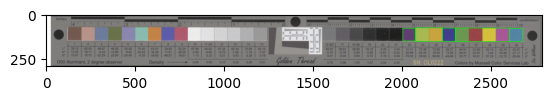

Image: ../images/cropped_scales/fixed\1701327421_scale_only.jpg

Pixels per cm: 115.1986183074266



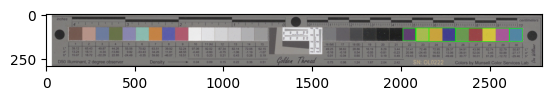

Image: ../images/cropped_scales/fixed\1701327524_scale_only.jpg

Pixels per cm: 115.37132987910189



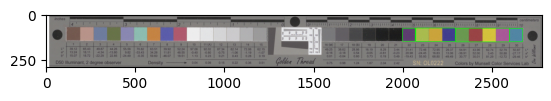

Image: ../images/cropped_scales/fixed\1701328021_scale_only.jpg

Pixels per cm: 115.02590673575129



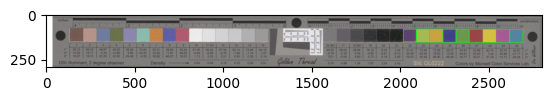

Image: ../images/cropped_scales/fixed\1701328048_scale_only.jpg

Pixels per cm: 115.02590673575129



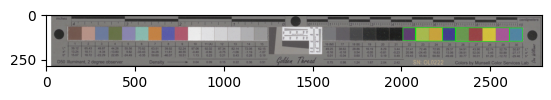

Image: ../images/cropped_scales/fixed\1701328713_a_scale_only.jpg

Pixels per cm: 114.853195164076



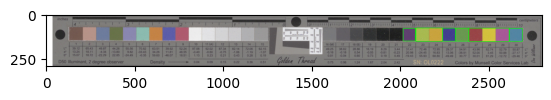

Image: ../images/cropped_scales/fixed\1701328713_b_scale_only.jpg

Pixels per cm: 114.853195164076



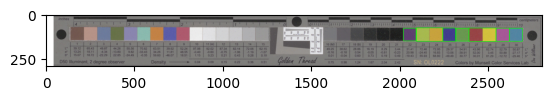

Image: ../images/cropped_scales/fixed\1701328728_scale_only.jpg

Pixels per cm: 115.02590673575129



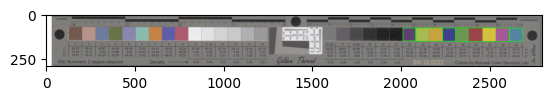

Image: ../images/cropped_scales/fixed\1701328823_scale_only.jpg

Pixels per cm: 115.02590673575129



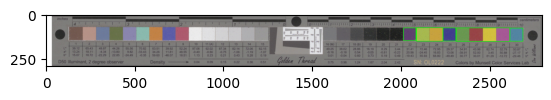

Image: ../images/cropped_scales/fixed\1701329020_scale_only.jpg

Pixels per cm: 114.853195164076



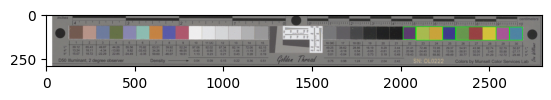

Image: ../images/cropped_scales/fixed\1701329753_scale_only.jpg

Pixels per cm: 115.71675302245251



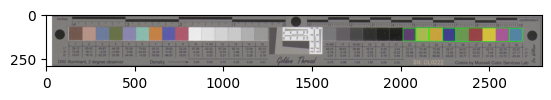

Image: ../images/cropped_scales/fixed\1701330349_a_scale_only.jpg

Pixels per cm: 115.02590673575129



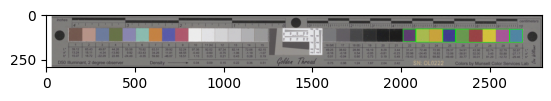

Image: ../images/cropped_scales/fixed\1701330485_scale_only.jpg

Pixels per cm: 115.1986183074266



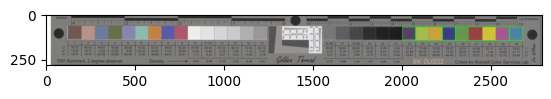

Image: ../images/cropped_scales/fixed\1701331155_scale_only.jpg

Pixels per cm: 115.37132987910189



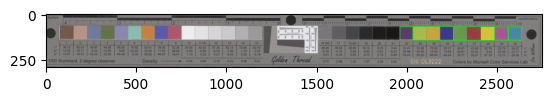

Image: ../images/cropped_scales/fixed\1701331762_scale_only.jpg

Pixels per cm: 114.68048359240069



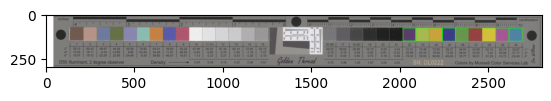

Image: ../images/cropped_scales/fixed\1701332376_scale_only.jpg

Pixels per cm: 118.82556131260795



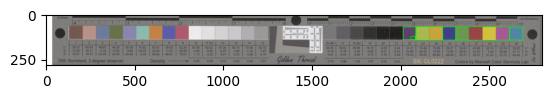

Image: ../images/cropped_scales/fixed\1701332728_scale_only.jpg

Pixels per cm: 115.37132987910189



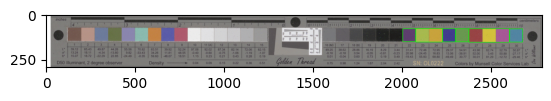

Image: ../images/cropped_scales/fixed\1701332763_scale_only.jpg

Pixels per cm: 115.02590673575129



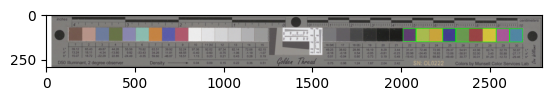

Image: ../images/cropped_scales/fixed\1701332905_scale_only.jpg

Pixels per cm: 114.853195164076



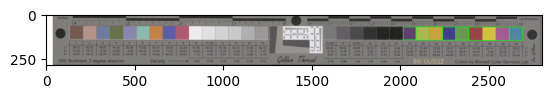

Image: ../images/cropped_scales/fixed\1701333207_scale_only.jpg

Pixels per cm: 115.1986183074266



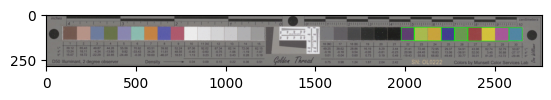

Image: ../images/cropped_scales/fixed\1701333465_scale_only.jpg

Pixels per cm: 114.853195164076



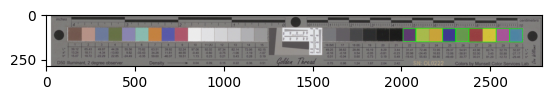

Image: ../images/cropped_scales/fixed\1701333601_scale_only.jpg

Pixels per cm: 117.27115716753022



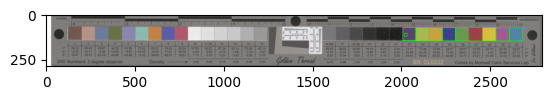

Image: ../images/cropped_scales/fixed\1701334039_scale_only.jpg

Pixels per cm: 115.02590673575129



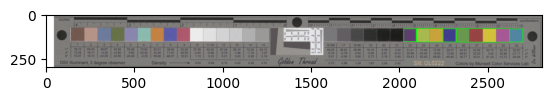

Image: ../images/cropped_scales/fixed\1701334499_scale_only.jpg

Pixels per cm: 115.37132987910189



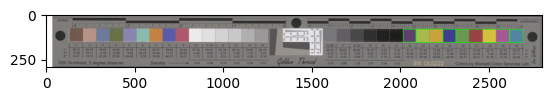

Image: ../images/cropped_scales/fixed\1701334711_scale_only.jpg

Pixels per cm: 115.1986183074266



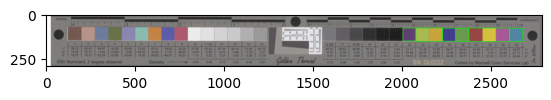

Image: ../images/cropped_scales/fixed\1701336132_scale_only.jpg

Pixels per cm: 118.82556131260795



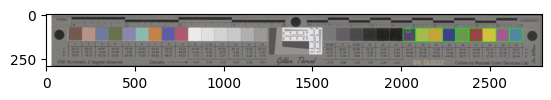

Image: ../images/cropped_scales/fixed\1701336781_scale_only.jpg

Pixels per cm: 115.37132987910189



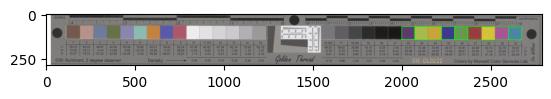

Image: ../images/cropped_scales/fixed\1701336985_scale_only.jpg

Pixels per cm: 115.37132987910189



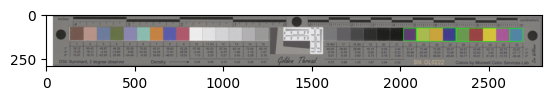

Image: ../images/cropped_scales/fixed\1701337185_scale_only.jpg

Pixels per cm: 115.02590673575129



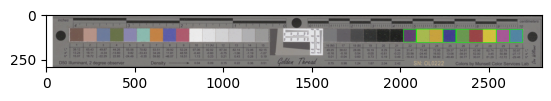

Image: ../images/cropped_scales/fixed\1701337703_scale_only.jpg

Pixels per cm: 115.5440414507772



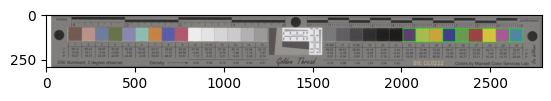

Image: ../images/cropped_scales/fixed\1701338363_scale_only.jpg

Pixels per cm: 115.1986183074266



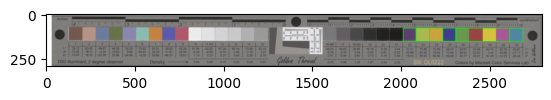

Image: ../images/cropped_scales/fixed\1701339075_scale_only.jpg

Pixels per cm: 117.09844559585493



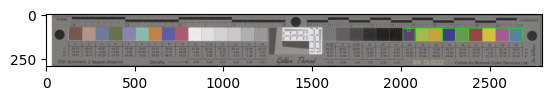

Image: ../images/cropped_scales/fixed\1701339724_scale_only.jpg

Pixels per cm: 115.37132987910189



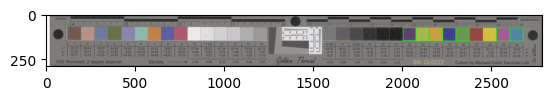

Image: ../images/cropped_scales/fixed\1701339910_scale_only.jpg

Pixels per cm: 115.02590673575129



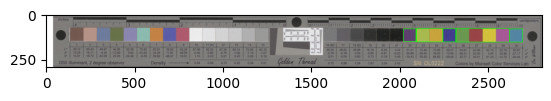

Image: ../images/cropped_scales/fixed\1701340543_scale_only.jpg

Pixels per cm: 114.50777202072538



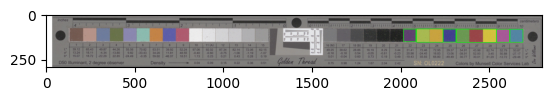

Image: ../images/cropped_scales/fixed\1701341030_scale_only.jpg

Pixels per cm: 115.71675302245251



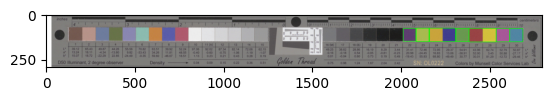

Image: ../images/cropped_scales/fixed\1701341421_scale_only.jpg

Pixels per cm: 117.09844559585493



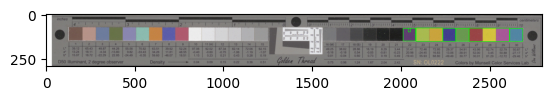

Image: ../images/cropped_scales/fixed\1701341884_scale_only.jpg

Pixels per cm: 115.37132987910189



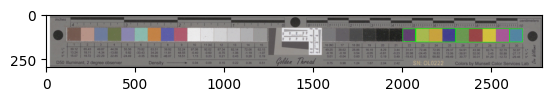

Image: ../images/cropped_scales/fixed\1701342133_scale_only.jpg

Pixels per cm: 118.13471502590673



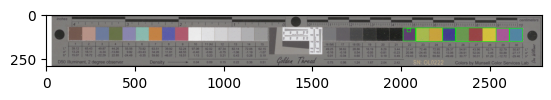

Image: ../images/cropped_scales/fixed\1701343029_scale_only.jpg

Pixels per cm: 114.68048359240069



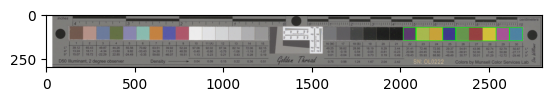

Image: ../images/cropped_scales/fixed\1701343309_scale_only.jpg

Pixels per cm: 115.5440414507772



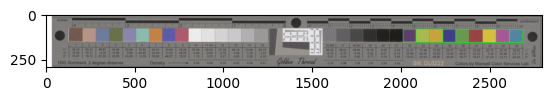

Image: ../images/cropped_scales/fixed\1701343994_scale_only.jpg

Pixels per cm: 115.1986183074266



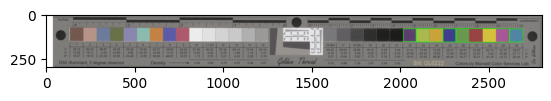

Image: ../images/cropped_scales/fixed\1701344409_scale_only.jpg

Pixels per cm: 114.853195164076



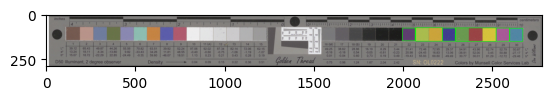

Image: ../images/cropped_scales/fixed\1701345421_scale_only.jpg

Pixels per cm: 115.37132987910189



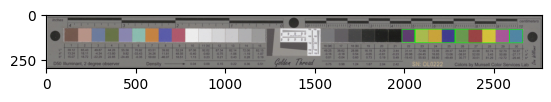

Image: ../images/cropped_scales/fixed\1701346167_scale_only.jpg

Pixels per cm: 122.6252158894646



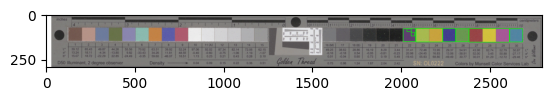

Image: ../images/cropped_scales/fixed\1701346207_scale_only.jpg

Pixels per cm: 115.02590673575129



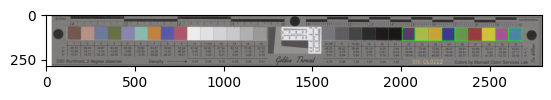

Image: ../images/cropped_scales/fixed\1701346299_scale_only.jpg

Pixels per cm: 115.02590673575129



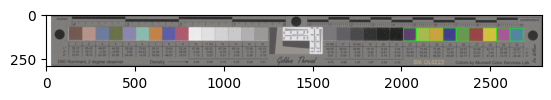

Image: ../images/cropped_scales/fixed\1701346321_scale_only.jpg

Pixels per cm: 115.1986183074266



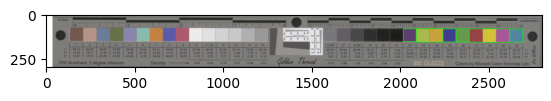

Image: ../images/cropped_scales/fixed\1701562440_a_scale_only.jpg

Pixels per cm: 118.48013816925734



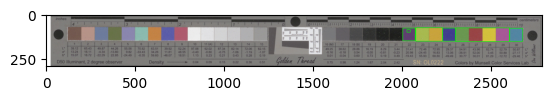

Image: ../images/cropped_scales/fixed\1701562440_b_scale_only.jpg

Pixels per cm: 114.68048359240069



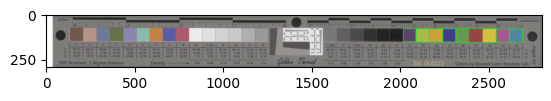

Image: ../images/cropped_scales/fixed\1701562550_scale_only.jpg

Pixels per cm: 116.75302245250431



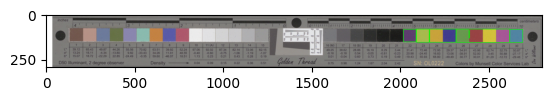

Image: ../images/cropped_scales/fixed\1701563381_scale_only.jpg

Pixels per cm: 115.1986183074266



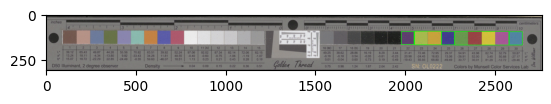

Image: ../images/cropped_scales/fixed\1701563613_scale_only.jpg

Pixels per cm: 115.37132987910189



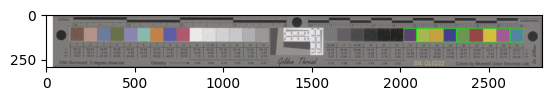

Image: ../images/cropped_scales/fixed\1701564061_scale_only.jpg

Pixels per cm: 115.1986183074266



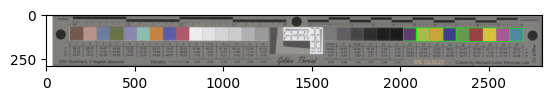

Image: ../images/cropped_scales/fixed\1701564127_scale_only.jpg

Pixels per cm: 115.37132987910189



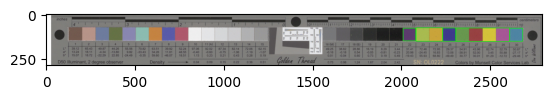

Image: ../images/cropped_scales/fixed\1701564248_scale_only.jpg

Pixels per cm: 114.853195164076



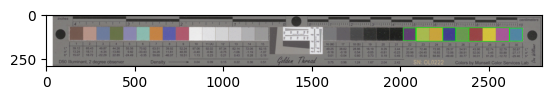

Image: ../images/cropped_scales/fixed\1701564420_scale_only.jpg

Pixels per cm: 114.853195164076



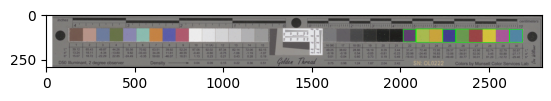

Image: ../images/cropped_scales/fixed\1701564649_scale_only.jpg

Pixels per cm: 115.1986183074266



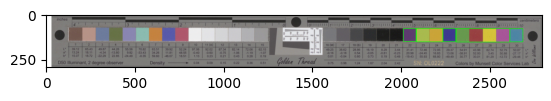

Image: ../images/cropped_scales/fixed\1701565314_scale_only.jpg

Pixels per cm: 115.8894645941278



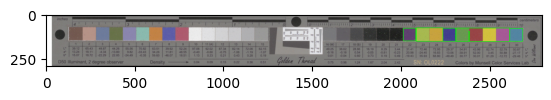

Image: ../images/cropped_scales/fixed\1701566566_scale_only.jpg

Pixels per cm: 115.02590673575129



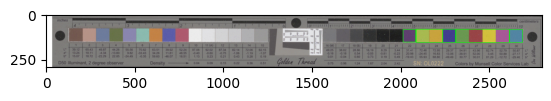

Image: ../images/cropped_scales/fixed\1701566604_scale_only.jpg

Pixels per cm: 116.06217616580311



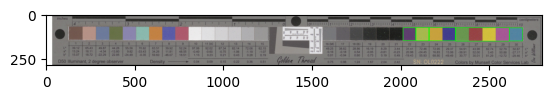

Image: ../images/cropped_scales/fixed\1701566721_scale_only.jpg

Pixels per cm: 115.5440414507772



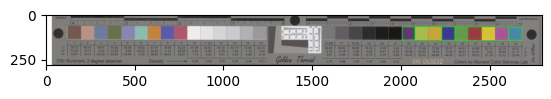

Image: ../images/cropped_scales/fixed\1701567318_scale_only.jpg

Pixels per cm: 115.37132987910189



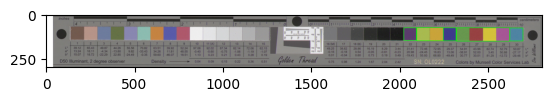

Image: ../images/cropped_scales/fixed\1701567995_scale_only.jpg

Pixels per cm: 114.853195164076



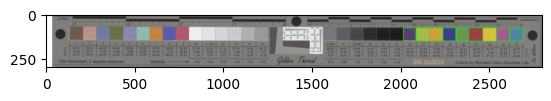

Image: ../images/cropped_scales/fixed\1701568966_scale_only.jpg

Pixels per cm: 115.1986183074266



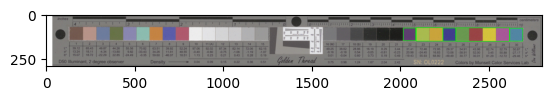

Image: ../images/cropped_scales/fixed\1701569219_scale_only.jpg

Pixels per cm: 115.5440414507772



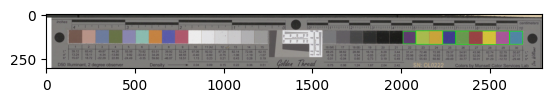

Image: ../images/cropped_scales/fixed\1701569654_scale_only.jpg

Pixels per cm: 115.02590673575129



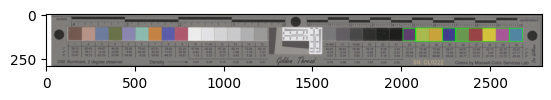

Image: ../images/cropped_scales/fixed\1701569756_scale_only.jpg

Pixels per cm: 115.37132987910189



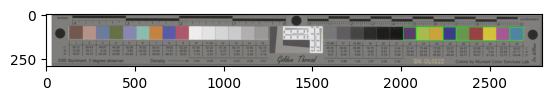

Image: ../images/cropped_scales/fixed\1701570087_scale_only.jpg

Pixels per cm: 116.92573402417962



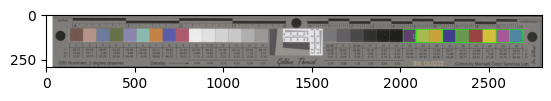

Image: ../images/cropped_scales/fixed\1701570223_scale_only.jpg

Pixels per cm: 114.68048359240069



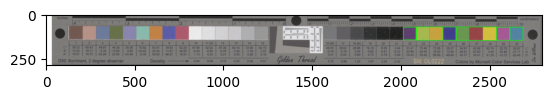

Image: ../images/cropped_scales/fixed\1701570242_scale_only.jpg

Pixels per cm: 115.37132987910189



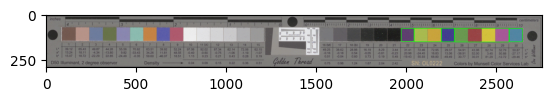

Image: ../images/cropped_scales/fixed\1701570895_scale_only.jpg

Pixels per cm: 115.1986183074266



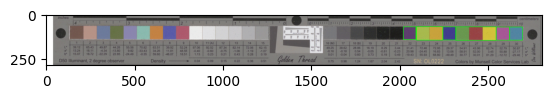

Image: ../images/cropped_scales/fixed\1701571224_scale_only.jpg

Pixels per cm: 115.37132987910189



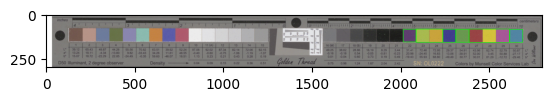

Image: ../images/cropped_scales/fixed\1701571346_scale_only.jpg

Pixels per cm: 114.853195164076



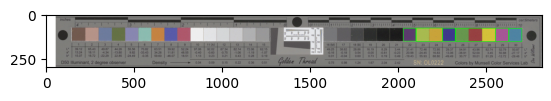

Image: ../images/cropped_scales/fixed\1701571646_scale_only.jpg

Pixels per cm: 121.07081174438687



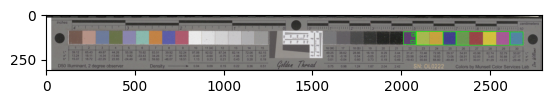

Image: ../images/cropped_scales/fixed\1701571864_scale_only.jpg

Pixels per cm: 115.5440414507772



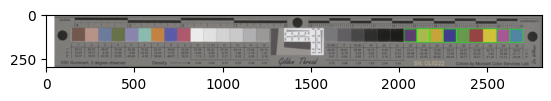

Image: ../images/cropped_scales/fixed\1701760478_scale_only.jpg

Pixels per cm: 115.37132987910189



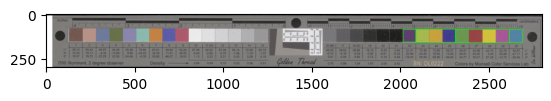

Image: ../images/cropped_scales/fixed\1701760815_scale_only.jpg

Pixels per cm: 117.78929188255613



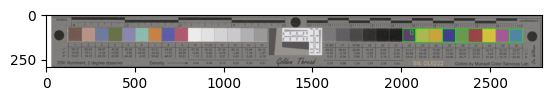

Image: ../images/cropped_scales/fixed\1701760923_scale_only.jpg

Pixels per cm: 115.02590673575129



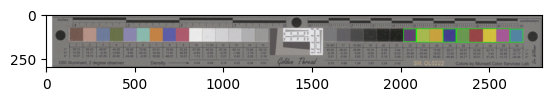

Image: ../images/cropped_scales/fixed\1701760926_scale_only.jpg

Pixels per cm: 115.37132987910189



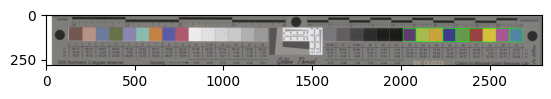

Image: ../images/cropped_scales/fixed\1701762159_scale_only.jpg

Pixels per cm: 115.71675302245251



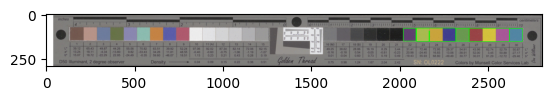

Image: ../images/cropped_scales/fixed\1701762673_scale_only.jpg

Pixels per cm: 117.44386873920553



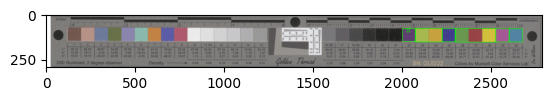

Image: ../images/cropped_scales/fixed\1701763072_scale_only.jpg

Pixels per cm: 115.02590673575129



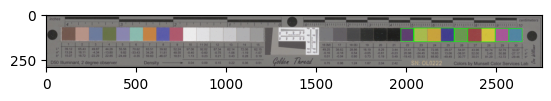

Image: ../images/cropped_scales/fixed\1701765069_scale_only.jpg

Pixels per cm: 115.02590673575129



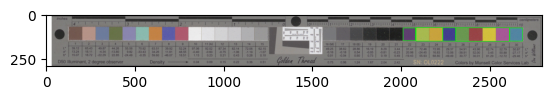

Image: ../images/cropped_scales/fixed\1701766098_scale_only.jpg

Pixels per cm: 115.5440414507772



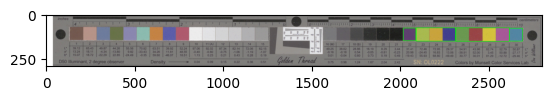

Image: ../images/cropped_scales/fixed\1701766223_scale_only.jpg

Pixels per cm: 115.5440414507772



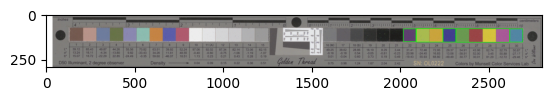

Image: ../images/cropped_scales/fixed\1701766354_scale_only.jpg

Pixels per cm: 115.37132987910189



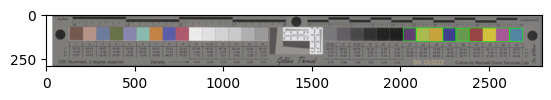

Image: ../images/cropped_scales/fixed\1701766993_scale_only.jpg

Pixels per cm: 114.853195164076



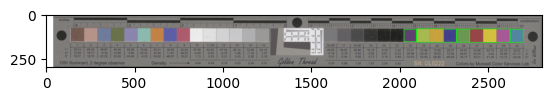

Image: ../images/cropped_scales/fixed\1701767463_scale_only.jpg

Pixels per cm: 115.02590673575129



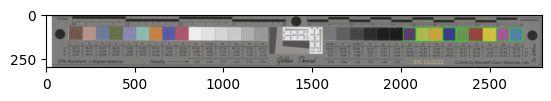

Image: ../images/cropped_scales/fixed\1701767734_scale_only.jpg

Pixels per cm: 114.853195164076



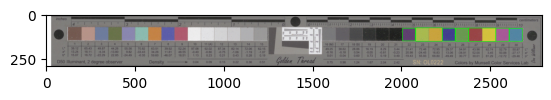

Image: ../images/cropped_scales/fixed\1701768563_scale_only.jpg

Pixels per cm: 115.1986183074266



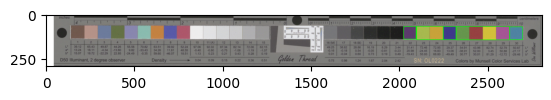

Image: ../images/cropped_scales/fixed\1701768669_scale_only.jpg

Pixels per cm: 115.1986183074266



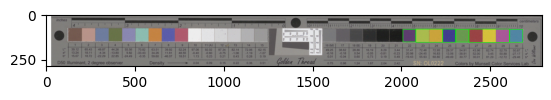

Image: ../images/cropped_scales/fixed\1701770585_scale_only.jpg

Pixels per cm: 115.1986183074266



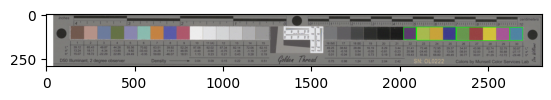

Image: ../images/cropped_scales/fixed\1701771029_scale_only.jpg

Pixels per cm: 115.5440414507772



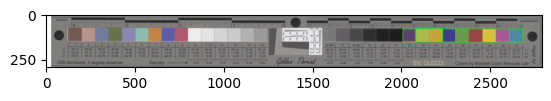

Image: ../images/cropped_scales/fixed\1701771853_scale_only.jpg

Pixels per cm: 118.48013816925734



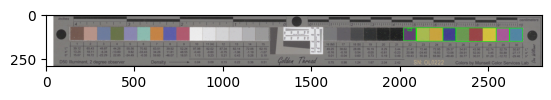

Image: ../images/cropped_scales/fixed\1701772195_a_scale_only.jpg

Pixels per cm: 115.71675302245251



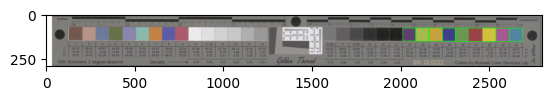

Image: ../images/cropped_scales/fixed\1701772195_b_scale_only.jpg

Pixels per cm: 115.02590673575129



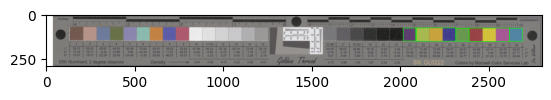

Image: ../images/cropped_scales/fixed\1701772786_scale_only.jpg

Pixels per cm: 115.71675302245251



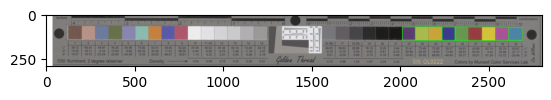

Image: ../images/cropped_scales/fixed\1701772974_scale_only.jpg

Pixels per cm: 103.62694300518135



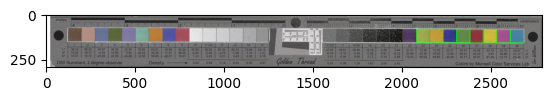

Image: ../images/cropped_scales/fixed\1701773012_scale_only.jpg

Pixels per cm: 115.02590673575129



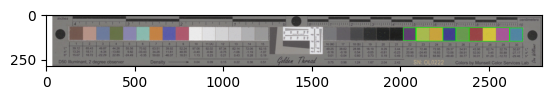

Image: ../images/cropped_scales/fixed\1701774479_scale_only.jpg

Pixels per cm: 115.02590673575129



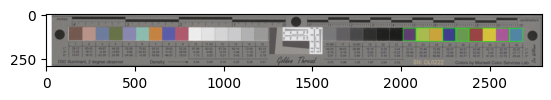

Image: ../images/cropped_scales/fixed\1701774655_scale_only.jpg

Pixels per cm: 115.37132987910189



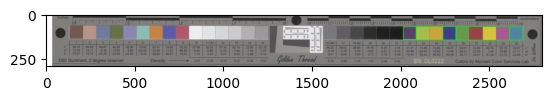

Image: ../images/cropped_scales/fixed\1701774726_scale_only.jpg

Pixels per cm: 117.96200345423144



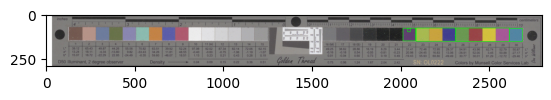

Image: ../images/cropped_scales/fixed\1701774990_a_scale_only.jpg

Pixels per cm: 115.5440414507772



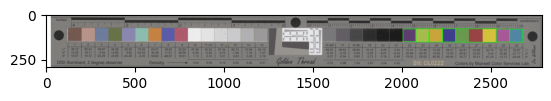

Image: ../images/cropped_scales/fixed\1701774990_b_scale_only.jpg

Pixels per cm: 115.37132987910189



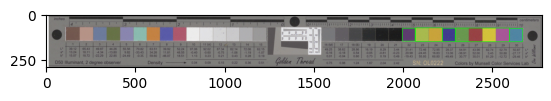

Image: ../images/cropped_scales/fixed\1701774994_a_scale_only.jpg

Pixels per cm: 116.23488773747842



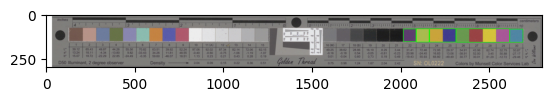

Image: ../images/cropped_scales/fixed\1701775038_scale_only.jpg

Pixels per cm: 115.37132987910189



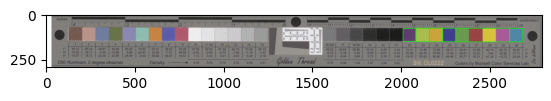

Image: ../images/cropped_scales/fixed\1701775065_a_scale_only.jpg

Pixels per cm: 115.37132987910189



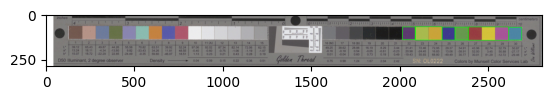

Image: ../images/cropped_scales/fixed\1701775065_b_scale_only.jpg

Pixels per cm: 115.5440414507772



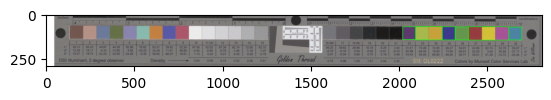

Image: ../images/cropped_scales/fixed\1701775065_c_scale_only.jpg

Pixels per cm: 115.37132987910189



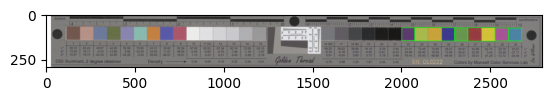

Image: ../images/cropped_scales/fixed\1701775633_scale_only.jpg

Pixels per cm: 115.02590673575129



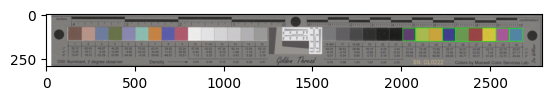

Image: ../images/cropped_scales/fixed\1701776263_scale_only.jpg

Pixels per cm: 115.5440414507772



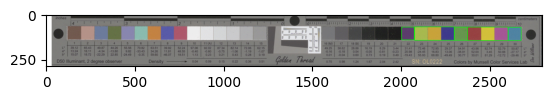

Image: ../images/cropped_scales/fixed\1701776299_a_scale_only.jpg

Pixels per cm: 115.5440414507772



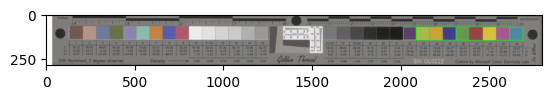

Image: ../images/cropped_scales/fixed\1701776299_b_scale_only.jpg

Pixels per cm: 115.1986183074266



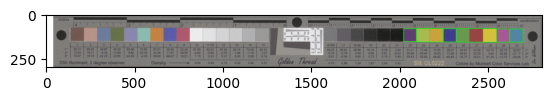

Image: ../images/cropped_scales/fixed\1701776428_scale_only.jpg

Pixels per cm: 104.31778929188256



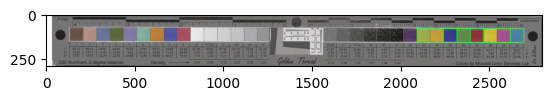

Image: ../images/cropped_scales/fixed\1701776750_scale_only.jpg

Pixels per cm: 114.68048359240069



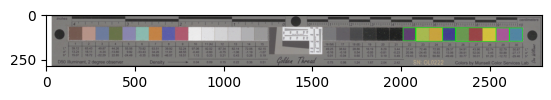

Image: ../images/cropped_scales/fixed\1701776876_scale_only.jpg

Pixels per cm: 115.37132987910189



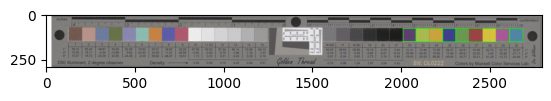

Image: ../images/cropped_scales/fixed\1701777008_scale_only.jpg

Pixels per cm: 115.37132987910189



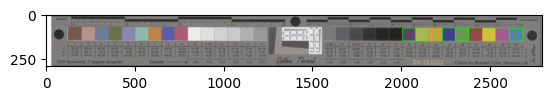

Image: ../images/cropped_scales/fixed\1701778407_scale_only.jpg

Pixels per cm: 115.5440414507772



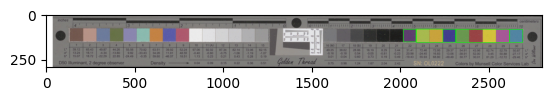

Image: ../images/cropped_scales/fixed\1701779754_a_scale_only.jpg

Pixels per cm: 115.71675302245251



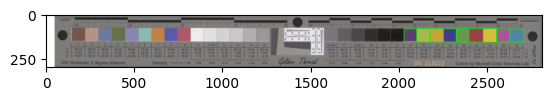

Image: ../images/cropped_scales/fixed\1701779754_b_scale_only.jpg

Pixels per cm: 115.1986183074266



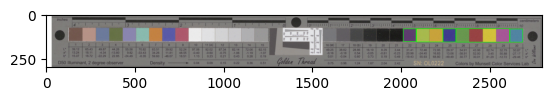

Image: ../images/cropped_scales/fixed\1701780120_scale_only.jpg

Pixels per cm: 115.1986183074266



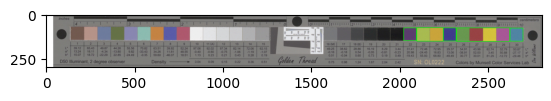

Image: ../images/cropped_scales/fixed\1701958652_scale_only.jpg

Pixels per cm: 115.02590673575129



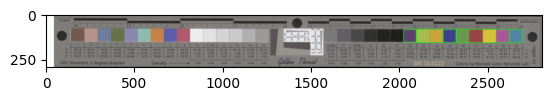

Image: ../images/cropped_scales/fixed\1701960916_scale_only.jpg

Pixels per cm: 115.37132987910189



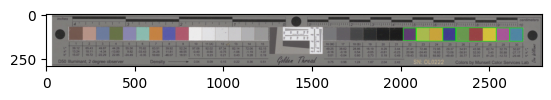

Image: ../images/cropped_scales/fixed\1701961134_scale_only.jpg

Pixels per cm: 117.78929188255613



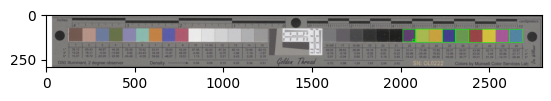

Image: ../images/cropped_scales/fixed\1701961207_scale_only.jpg

Pixels per cm: 115.02590673575129



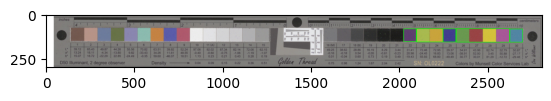

Image: ../images/cropped_scales/fixed\1701961527_scale_only.jpg

Pixels per cm: 114.68048359240069



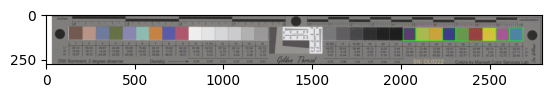

Image: ../images/cropped_scales/fixed\1701961921_scale_only.jpg

Pixels per cm: 115.5440414507772



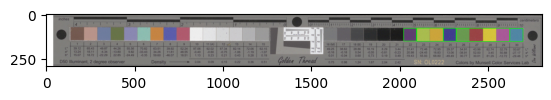

Image: ../images/cropped_scales/fixed\1701962034_scale_only.jpg

Pixels per cm: 115.37132987910189



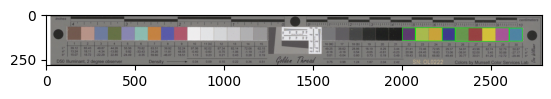

Image: ../images/cropped_scales/fixed\1701962384_scale_only.jpg

Pixels per cm: 115.37132987910189



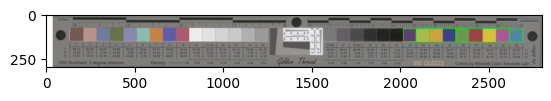

Image: ../images/cropped_scales/fixed\1701963312_scale_only.jpg

Pixels per cm: 115.1986183074266



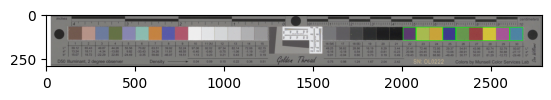

Image: ../images/cropped_scales/fixed\1701963385_scale_only.jpg

Pixels per cm: 115.37132987910189



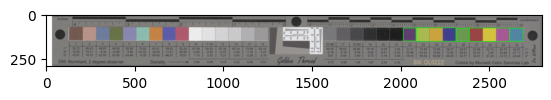

Image: ../images/cropped_scales/fixed\1701964085_scale_only.jpg

Pixels per cm: 115.1986183074266



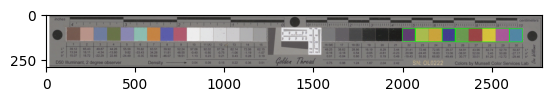

Image: ../images/cropped_scales/fixed\1701964331_scale_only.jpg

Pixels per cm: 114.853195164076



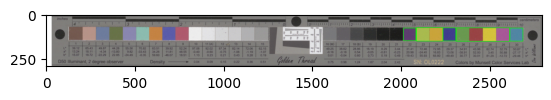

Image: ../images/cropped_scales/fixed\1701964413_scale_only.jpg

Pixels per cm: 115.02590673575129



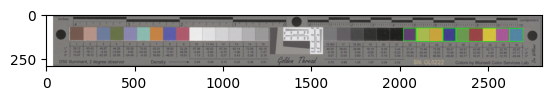

Image: ../images/cropped_scales/fixed\1701964550_scale_only.jpg

Pixels per cm: 115.37132987910189



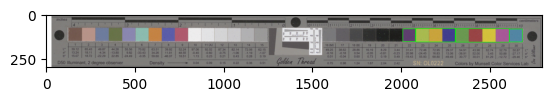

Image: ../images/cropped_scales/fixed\1701964888_scale_only.jpg

Pixels per cm: 117.78929188255613



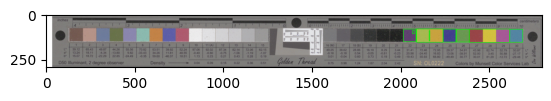

Image: ../images/cropped_scales/fixed\1701964979_scale_only.jpg

Pixels per cm: 115.5440414507772



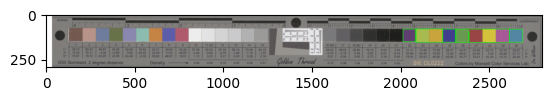

Image: ../images/cropped_scales/fixed\1701965830_scale_only.jpg

Pixels per cm: 115.37132987910189



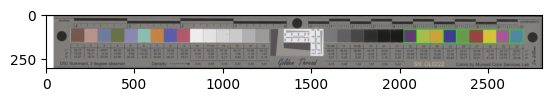

Image: ../images/cropped_scales/fixed\1701965862_scale_only.jpg

Pixels per cm: 116.06217616580311



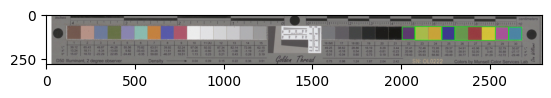

Image: ../images/cropped_scales/fixed\1701966923_scale_only.jpg

Pixels per cm: 115.02590673575129



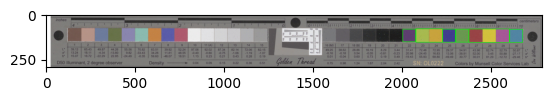

Image: ../images/cropped_scales/fixed\1701967079_scale_only.jpg

Pixels per cm: 115.1986183074266



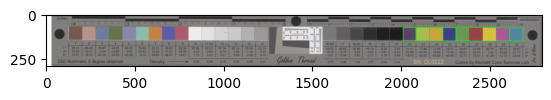

Image: ../images/cropped_scales/fixed\1701967081_a_scale_only.jpg

Pixels per cm: 115.1986183074266



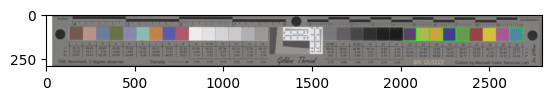

Image: ../images/cropped_scales/fixed\1701967081_b_scale_only.jpg

Pixels per cm: 114.853195164076



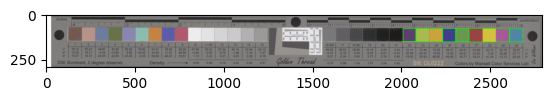

Image: ../images/cropped_scales/fixed\1701967237_scale_only.jpg

Pixels per cm: 115.37132987910189



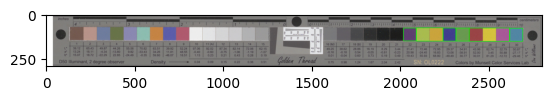

Image: ../images/cropped_scales/fixed\1701967276_scale_only.jpg

Pixels per cm: 114.853195164076



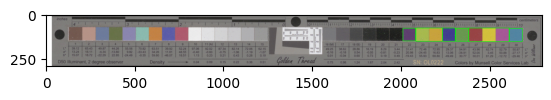

Image: ../images/cropped_scales/fixed\1701967796_scale_only.jpg

Pixels per cm: 115.37132987910189



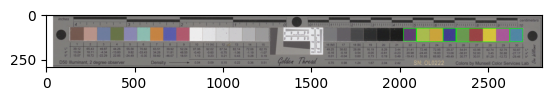

Image: ../images/cropped_scales/fixed\1701967973_scale_only.jpg

Pixels per cm: 115.8894645941278



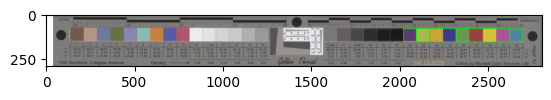

Image: ../images/cropped_scales/fixed\1701969554_scale_only.jpg

Pixels per cm: 115.02590673575129



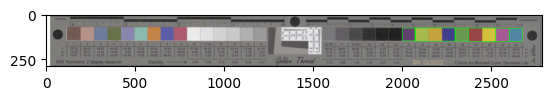

Image: ../images/cropped_scales/fixed\1701969714_scale_only.jpg

Pixels per cm: 117.78929188255613



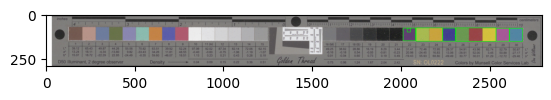

Image: ../images/cropped_scales/fixed\1701970203_scale_only.jpg

Pixels per cm: 115.02590673575129



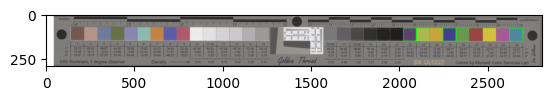

Image: ../images/cropped_scales/fixed\1701970253_a_scale_only.jpg

Pixels per cm: 115.37132987910189



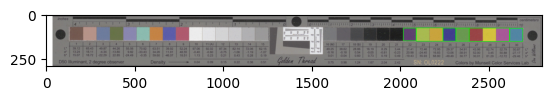

Image: ../images/cropped_scales/fixed\1701970253_b_scale_only.jpg

Pixels per cm: 115.02590673575129



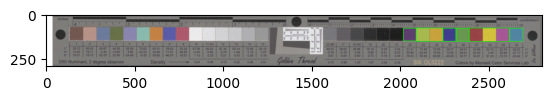

Image: ../images/cropped_scales/fixed\1701970422_scale_only.jpg

Pixels per cm: 115.02590673575129



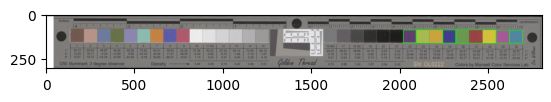

Image: ../images/cropped_scales/fixed\1701970631_scale_only.jpg

Pixels per cm: 114.853195164076



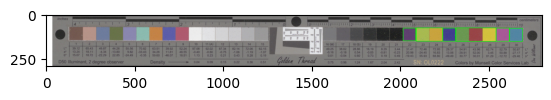

Image: ../images/cropped_scales/fixed\1702515738_scale_only.jpg

Pixels per cm: 114.853195164076



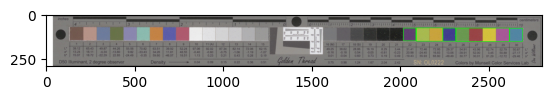

Image: ../images/cropped_scales/fixed\1702515874_scale_only.jpg

Pixels per cm: 115.02590673575129



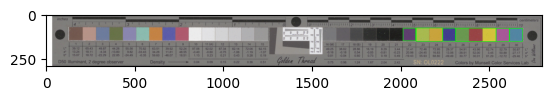

Image: ../images/cropped_scales/fixed\1702516197_scale_only.jpg

Pixels per cm: 118.99827288428325



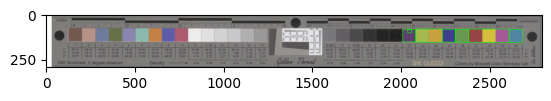

Image: ../images/cropped_scales/fixed\1702516584_scale_only.jpg

Pixels per cm: 115.37132987910189



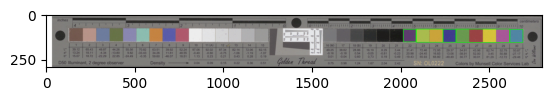

Image: ../images/cropped_scales/fixed\1702560147_scale_only.jpg

Pixels per cm: 114.853195164076



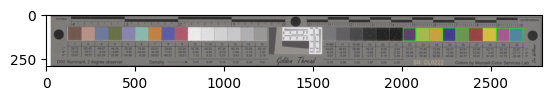

Image: ../images/cropped_scales/fixed\1805284800_b_scale_only.jpg

Pixels per cm: 115.1986183074266



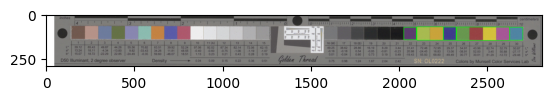

Image: ../images/cropped_scales/fixed\187079412_scale_only.jpg

Pixels per cm: 115.02590673575129



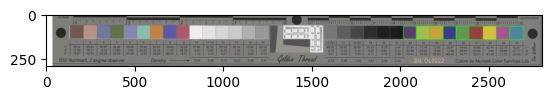

Image: ../images/cropped_scales/fixed\187080179_scale_only.jpg

Pixels per cm: 115.1986183074266



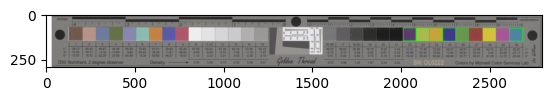

Image: ../images/cropped_scales/fixed\187080507_scale_only.jpg

Pixels per cm: 115.1986183074266



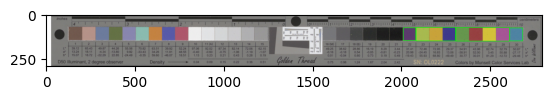

Image: ../images/cropped_scales/fixed\187082556_scale_only.jpg

Pixels per cm: 115.1986183074266



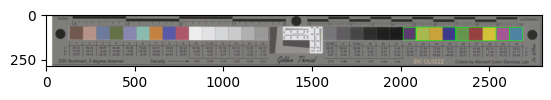

Image: ../images/cropped_scales/fixed\187084321_scale_only.jpg

Pixels per cm: 115.1986183074266



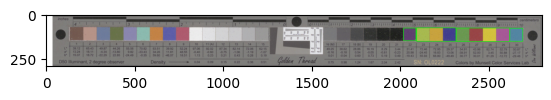

Image: ../images/cropped_scales/fixed\187089866_scale_only.jpg

Pixels per cm: 119.34369602763385



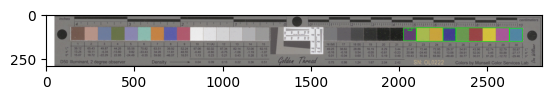

Image: ../images/cropped_scales/fixed\187092650_scale_only.jpg

Pixels per cm: 115.5440414507772



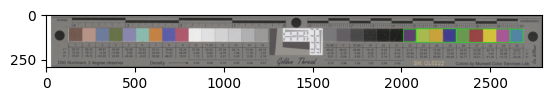

Image: ../images/cropped_scales/fixed\187094012_scale_only.jpg

Pixels per cm: 115.37132987910189



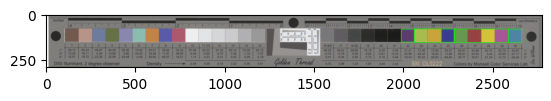

Image: ../images/cropped_scales/fixed\187095311_scale_only.jpg

Pixels per cm: 115.02590673575129



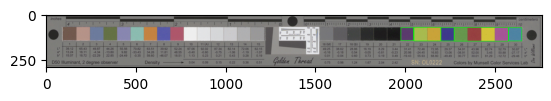

Image: ../images/cropped_scales/fixed\187095520_scale_only.jpg

Pixels per cm: 115.71675302245251



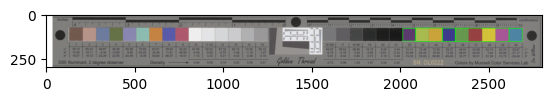

Image: ../images/cropped_scales/fixed\187095545_scale_only.jpg

Pixels per cm: 115.37132987910189



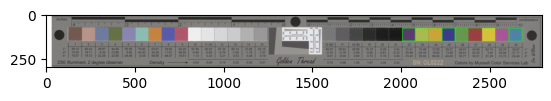

Image: ../images/cropped_scales/fixed\187097128_scale_only.jpg

Pixels per cm: 115.8894645941278



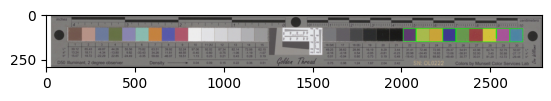

Image: ../images/cropped_scales/fixed\187097168_scale_only.jpg

Pixels per cm: 115.1986183074266



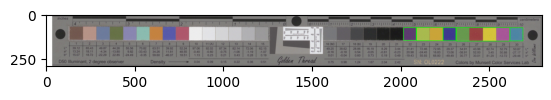

Image: ../images/cropped_scales/fixed\187097600_scale_only.jpg

Pixels per cm: 114.68048359240069



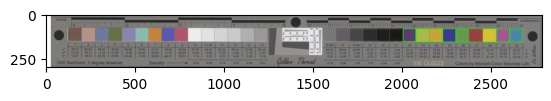

Image: ../images/cropped_scales/fixed\187098028_scale_only.jpg

Pixels per cm: 114.853195164076



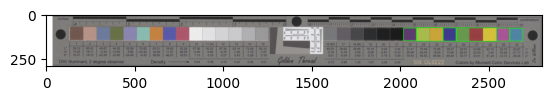

Image: ../images/cropped_scales/fixed\187100909_scale_only.jpg

Pixels per cm: 114.853195164076



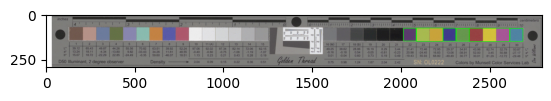

Image: ../images/cropped_scales/fixed\187103397_a_scale_only.jpg

Pixels per cm: 114.68048359240069



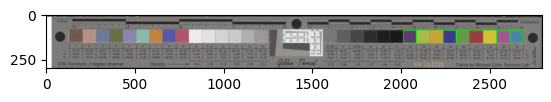

Image: ../images/cropped_scales/fixed\187103397_b_scale_only.jpg

Pixels per cm: 114.853195164076



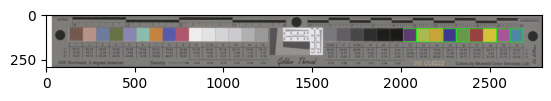

Image: ../images/cropped_scales/fixed\187106802_scale_only.jpg

Pixels per cm: 115.37132987910189



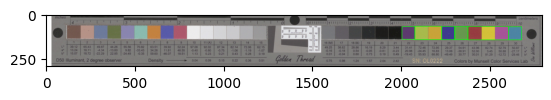

Image: ../images/cropped_scales/fixed\187108351_scale_only.jpg

Pixels per cm: 115.37132987910189



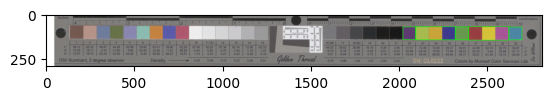

Image: ../images/cropped_scales/fixed\187109895_scale_only.jpg

Pixels per cm: 115.37132987910189



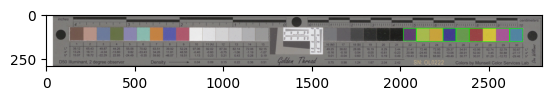

Image: ../images/cropped_scales/fixed\187114636_scale_only.jpg

Pixels per cm: 118.82556131260795



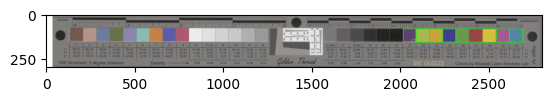

Image: ../images/cropped_scales/fixed\187115974_scale_only.jpg

Pixels per cm: 116.75302245250431



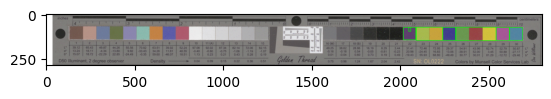

Image: ../images/cropped_scales/fixed\187118231_scale_only.jpg

Pixels per cm: 114.853195164076



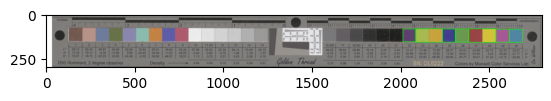

Image: ../images/cropped_scales/fixed\187118679_a_scale_only.jpg

Pixels per cm: 115.1986183074266



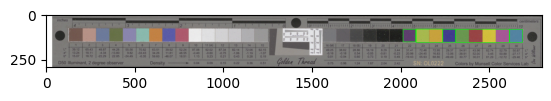

Image: ../images/cropped_scales/fixed\187118679_b_scale_only.jpg

Pixels per cm: 114.853195164076



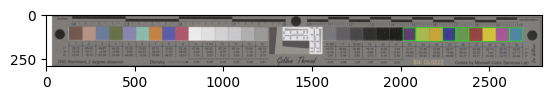

Image: ../images/cropped_scales/fixed\187119415_scale_only.jpg

Pixels per cm: 115.37132987910189



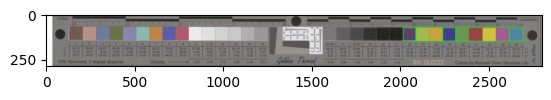

Image: ../images/cropped_scales/fixed\187125216_scale_only.jpg

Pixels per cm: 115.02590673575129



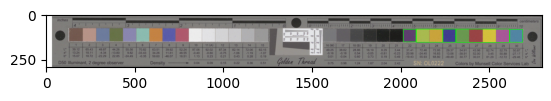

Image: ../images/cropped_scales/fixed\187129842_scale_only.jpg

Pixels per cm: 115.1986183074266



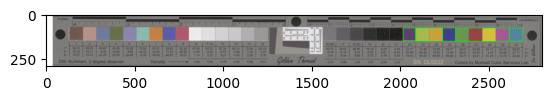

Image: ../images/cropped_scales/fixed\187130433_scale_only.jpg

Pixels per cm: 114.853195164076



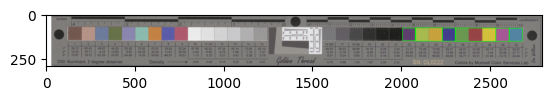

Image: ../images/cropped_scales/fixed\187131687_scale_only.jpg

Pixels per cm: 115.5440414507772



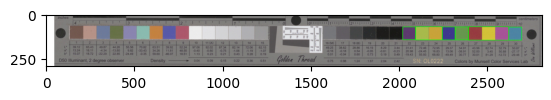

Image: ../images/cropped_scales/fixed\187133836_scale_only.jpg

Pixels per cm: 114.853195164076



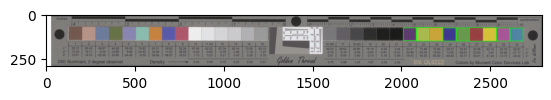

Image: ../images/cropped_scales/fixed\187134222_scale_only.jpg

Pixels per cm: 114.853195164076



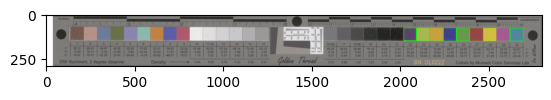

Image: ../images/cropped_scales/fixed\187134839_a_scale_only.jpg

Pixels per cm: 119.86183074265976



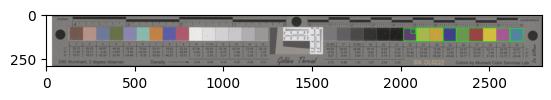

Image: ../images/cropped_scales/fixed\187134839_b_scale_only.jpg

Pixels per cm: 115.02590673575129



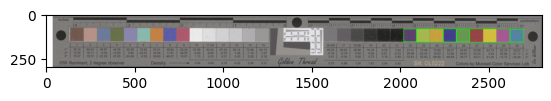

Image: ../images/cropped_scales/fixed\187135149_scale_only.jpg

Pixels per cm: 120.72538860103627



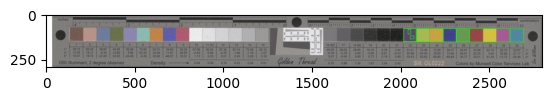

Image: ../images/cropped_scales/fixed\187136194_scale_only.jpg

Pixels per cm: 115.1986183074266



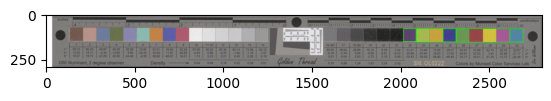

Image: ../images/cropped_scales/fixed\187136304_scale_only.jpg

Pixels per cm: 115.1986183074266



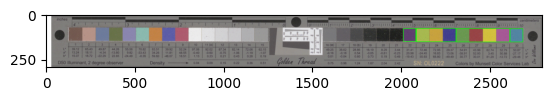

Image: ../images/cropped_scales/fixed\187136592_scale_only.jpg

Pixels per cm: 114.853195164076



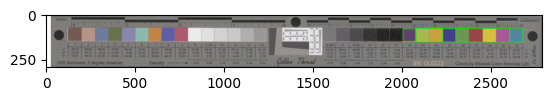

Image: ../images/cropped_scales/fixed\187137333_scale_only.jpg

Pixels per cm: 115.02590673575129



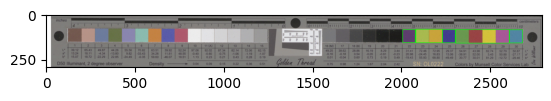

Image: ../images/cropped_scales/fixed\187139912_a_scale_only.jpg

Pixels per cm: 115.02590673575129



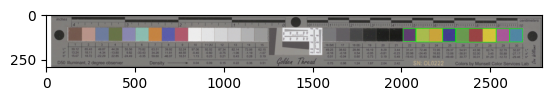

Image: ../images/cropped_scales/fixed\187139912_b_scale_only.jpg

Pixels per cm: 115.5440414507772



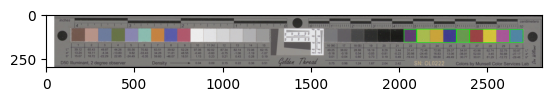

Image: ../images/cropped_scales/fixed\187141071_scale_only.jpg

Pixels per cm: 115.5440414507772



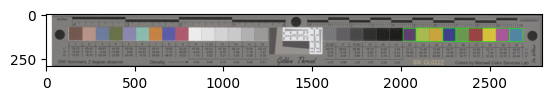

Image: ../images/cropped_scales/fixed\187142969_scale_only.jpg

Pixels per cm: 114.68048359240069



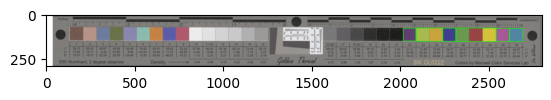

Image: ../images/cropped_scales/fixed\187144537_a_scale_only.jpg

Pixels per cm: 115.37132987910189



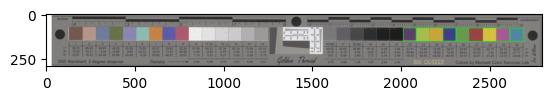

Image: ../images/cropped_scales/fixed\187144537_b_scale_only.jpg

Pixels per cm: 115.1986183074266



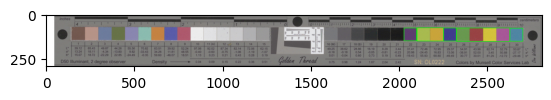

Image: ../images/cropped_scales/fixed\187145289_scale_only.jpg

Pixels per cm: 115.8894645941278



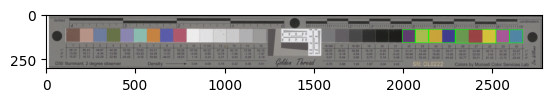

Image: ../images/cropped_scales/fixed\187146904_a_scale_only.jpg

Pixels per cm: 115.37132987910189



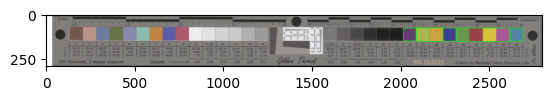

Image: ../images/cropped_scales/fixed\187146904_b_scale_only.jpg

Pixels per cm: 115.02590673575129



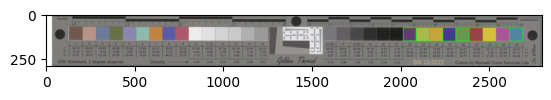

Image: ../images/cropped_scales/fixed\187148599_scale_only.jpg

Pixels per cm: 115.02590673575129



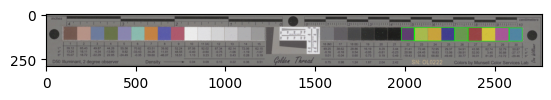

Image: ../images/cropped_scales/fixed\187154968_scale_only.jpg

Pixels per cm: 115.1986183074266



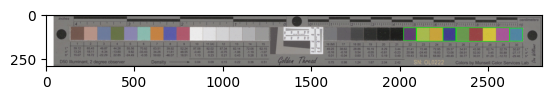

Image: ../images/cropped_scales/fixed\187158194_scale_only.jpg

Pixels per cm: 118.65284974093264



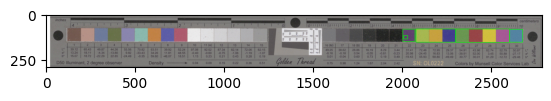

Image: ../images/cropped_scales/fixed\187158964_scale_only.jpg

Pixels per cm: 116.06217616580311



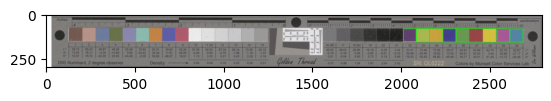

Image: ../images/cropped_scales/fixed\187161062_a_scale_only.jpg

Pixels per cm: 115.37132987910189



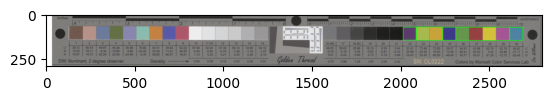

Image: ../images/cropped_scales/fixed\187161062_b_scale_only.jpg

Pixels per cm: 115.5440414507772



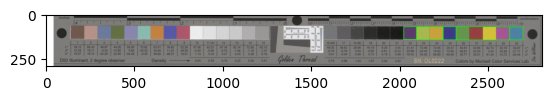

Image: ../images/cropped_scales/fixed\187168114_scale_only.jpg

Pixels per cm: 115.02590673575129



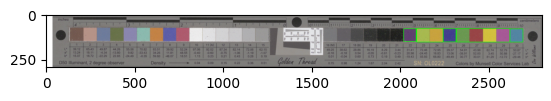

Image: ../images/cropped_scales/fixed\187170307_scale_only.jpg

Pixels per cm: 121.24352331606218



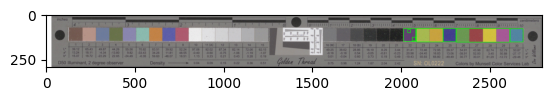

Image: ../images/cropped_scales/fixed\187170481_scale_only.jpg

Pixels per cm: 115.1986183074266



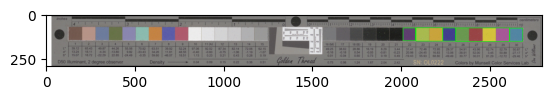

Image: ../images/cropped_scales/fixed\187175184_scale_only.jpg

Pixels per cm: 115.5440414507772



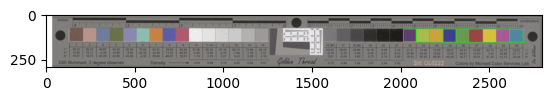

Image: ../images/cropped_scales/fixed\187176794_scale_only.jpg

Pixels per cm: 114.853195164076



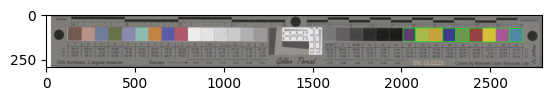

Image: ../images/cropped_scales/fixed\187179775_scale_only.jpg

Pixels per cm: 115.5440414507772



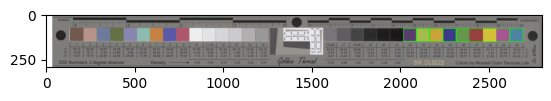

Image: ../images/cropped_scales/fixed\187179825_scale_only.jpg

Pixels per cm: 115.02590673575129



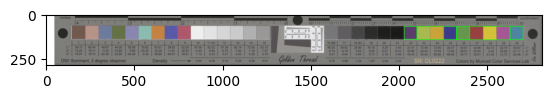

Image: ../images/cropped_scales/fixed\187183103_scale_only.jpg

Pixels per cm: 115.37132987910189



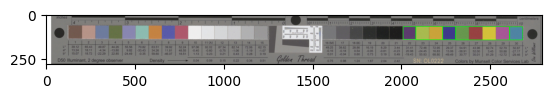

Image: ../images/cropped_scales/fixed\187183516_scale_only.jpg

Pixels per cm: 119.17098445595855



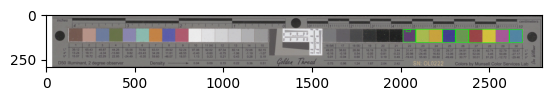

Image: ../images/cropped_scales/fixed\187184193_scale_only.jpg

Pixels per cm: 114.50777202072538



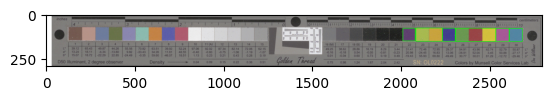

Image: ../images/cropped_scales/fixed\187185651_scale_only.jpg

Pixels per cm: 114.50777202072538



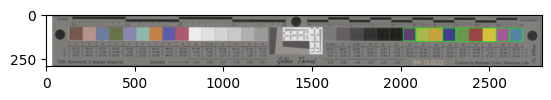

Image: ../images/cropped_scales/fixed\187189052_scale_only.jpg

Pixels per cm: 114.50777202072538



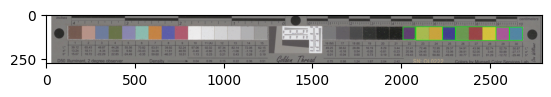

Image: ../images/cropped_scales/fixed\187193634_scale_only.jpg

Pixels per cm: 116.06217616580311



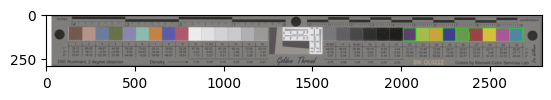

Image: ../images/cropped_scales/fixed\187194288_scale_only.jpg

Pixels per cm: 115.1986183074266



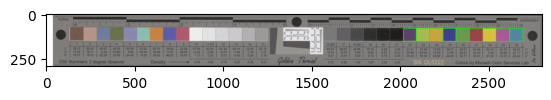

Image: ../images/cropped_scales/fixed\187196301_scale_only.jpg

Pixels per cm: 115.5440414507772



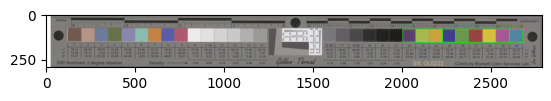

Image: ../images/cropped_scales/fixed\187198334_scale_only.jpg

Pixels per cm: 115.5440414507772



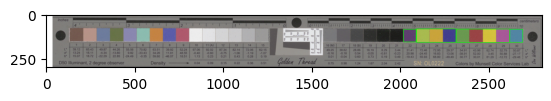

Image: ../images/cropped_scales/fixed\187200645_scale_only.jpg

Pixels per cm: 122.45250431778929



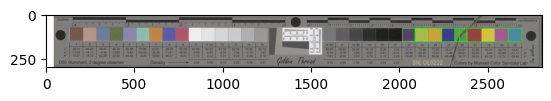

Image: ../images/cropped_scales/fixed\187204868_a_scale_only.jpg

Pixels per cm: 115.1986183074266



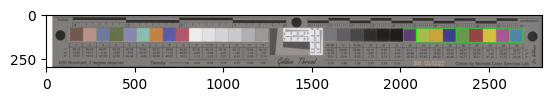

Image: ../images/cropped_scales/fixed\187204868_b_scale_only.jpg

Pixels per cm: 116.23488773747842



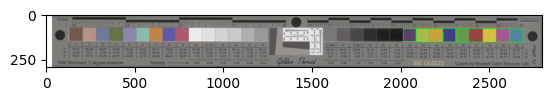

Image: ../images/cropped_scales/fixed\187205112_scale_only.jpg

Pixels per cm: 115.02590673575129



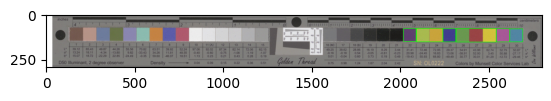

Image: ../images/cropped_scales/fixed\187207216_scale_only.jpg

Pixels per cm: 115.5440414507772



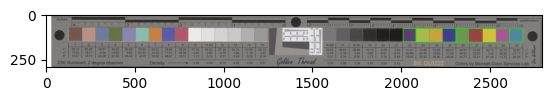

Image: ../images/cropped_scales/fixed\187210079_scale_only.jpg

Pixels per cm: 115.37132987910189



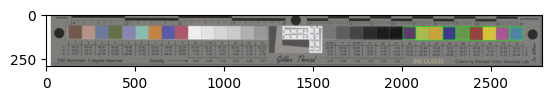

Image: ../images/cropped_scales/fixed\187210320_scale_only.jpg

Pixels per cm: 115.37132987910189



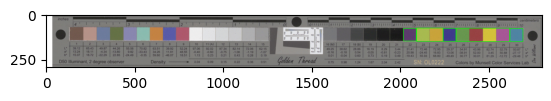

Image: ../images/cropped_scales/fixed\187217345_scale_only.jpg

Pixels per cm: 116.06217616580311



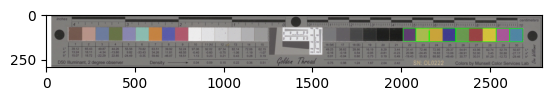

Image: ../images/cropped_scales/fixed\187218161_scale_only.jpg

Pixels per cm: 116.75302245250431



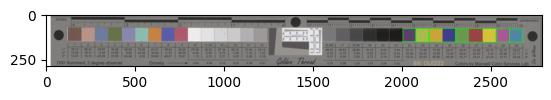

Image: ../images/cropped_scales/fixed\187220194_scale_only.jpg

Pixels per cm: 120.89810017271157



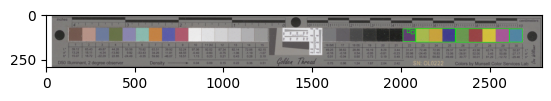

Image: ../images/cropped_scales/fixed\187227898_scale_only.jpg

Pixels per cm: 115.02590673575129



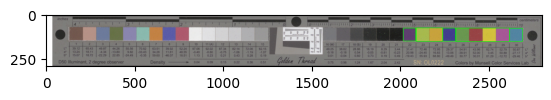

Image: ../images/cropped_scales/fixed\187231444_scale_only.jpg

Pixels per cm: 115.8894645941278



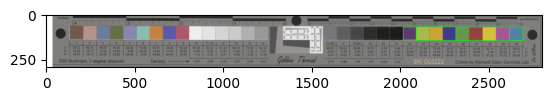

Image: ../images/cropped_scales/fixed\187232628_a_scale_only.jpg

Pixels per cm: 115.71675302245251



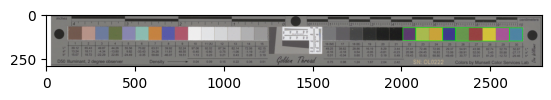

Image: ../images/cropped_scales/fixed\187232628_b_scale_only.jpg

Pixels per cm: 115.5440414507772



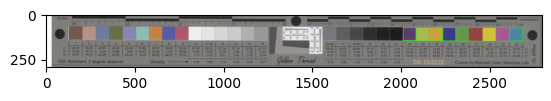

Image: ../images/cropped_scales/fixed\187233627_scale_only.jpg

Pixels per cm: 115.1986183074266



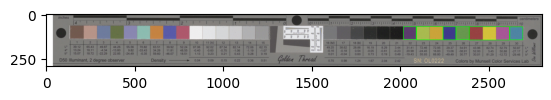

Image: ../images/cropped_scales/fixed\187233728_scale_only.jpg

Pixels per cm: 115.37132987910189



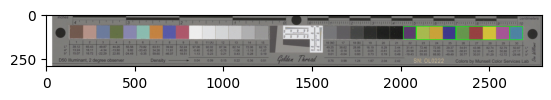

Image: ../images/cropped_scales/fixed\187235803_scale_only.jpg

Pixels per cm: 115.37132987910189



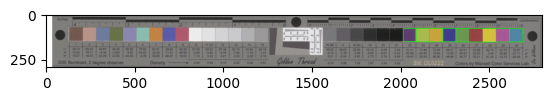

Image: ../images/cropped_scales/fixed\187236381_scale_only.jpg

Pixels per cm: 114.853195164076



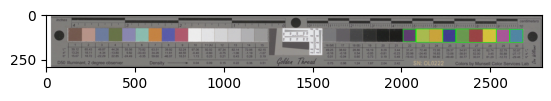

Image: ../images/cropped_scales/fixed\187238542_scale_only.jpg

Pixels per cm: 114.68048359240069



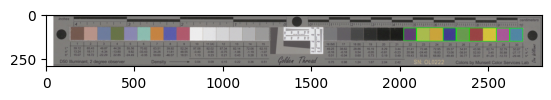

Image: ../images/cropped_scales/fixed\187239130_scale_only.jpg

Pixels per cm: 117.27115716753022



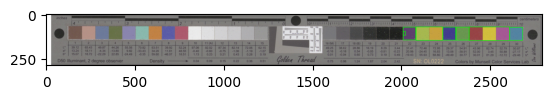

Image: ../images/cropped_scales/fixed\187240446_scale_only.jpg

Pixels per cm: 115.1986183074266



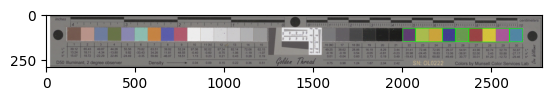

Image: ../images/cropped_scales/fixed\187241648_scale_only.jpg

Pixels per cm: 115.5440414507772



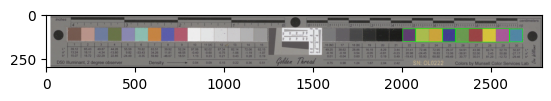

Image: ../images/cropped_scales/fixed\187244644_scale_only.jpg

Pixels per cm: 115.02590673575129



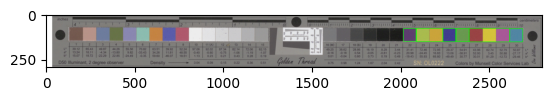

Image: ../images/cropped_scales/fixed\187244743_scale_only.jpg

Pixels per cm: 115.37132987910189



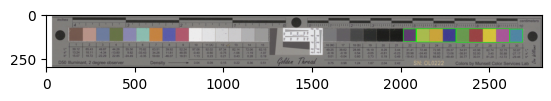

Image: ../images/cropped_scales/fixed\187245652_scale_only.jpg

Pixels per cm: 115.37132987910189



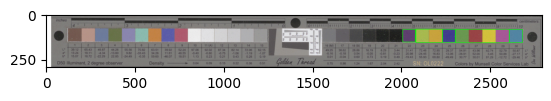

Image: ../images/cropped_scales/fixed\187245794_scale_only.jpg

Pixels per cm: 114.853195164076



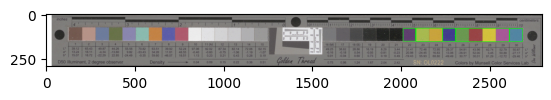

Image: ../images/cropped_scales/fixed\187246105_scale_only.jpg

Pixels per cm: 114.33506044905009



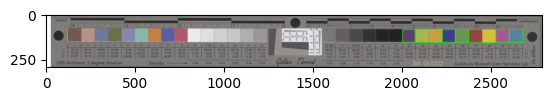

Image: ../images/cropped_scales/fixed\187252009_scale_only.jpg

Pixels per cm: 114.68048359240069



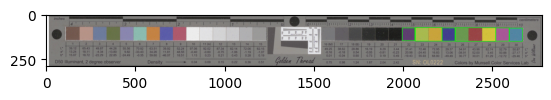

Image: ../images/cropped_scales/fixed\187252197_scale_only.jpg

Pixels per cm: 114.68048359240069



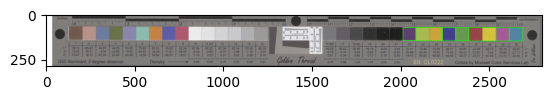

Image: ../images/cropped_scales/fixed\187255047_scale_only.jpg

Pixels per cm: 118.48013816925734



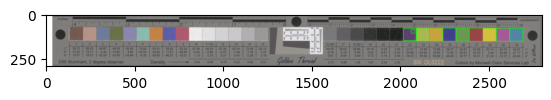

Image: ../images/cropped_scales/fixed\187256130_scale_only.jpg

Pixels per cm: 117.44386873920553



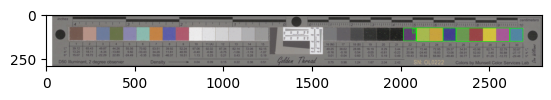

Image: ../images/cropped_scales/fixed\187257453_scale_only.jpg

Pixels per cm: 116.23488773747842



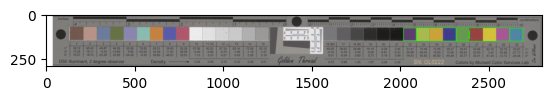

Image: ../images/cropped_scales/fixed\187260597_scale_only.jpg

Pixels per cm: 115.37132987910189



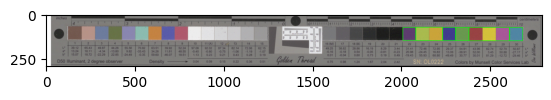

Image: ../images/cropped_scales/fixed\187261359_scale_only.jpg

Pixels per cm: 115.1986183074266



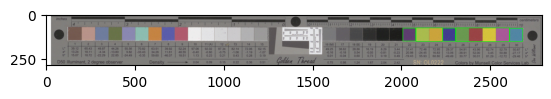

Image: ../images/cropped_scales/fixed\187261777_scale_only.jpg

Pixels per cm: 115.1986183074266



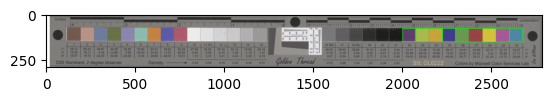

Image: ../images/cropped_scales/fixed\187264005_scale_only.jpg

Pixels per cm: 115.37132987910189



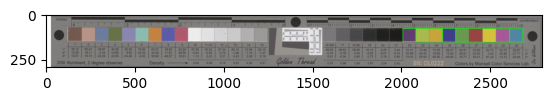

Image: ../images/cropped_scales/fixed\187267965_scale_only.jpg

Pixels per cm: 115.1986183074266



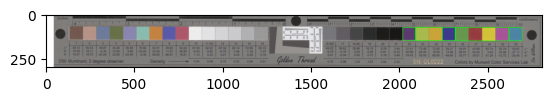

Image: ../images/cropped_scales/fixed\187275292_scale_only.jpg

Pixels per cm: 117.61658031088083



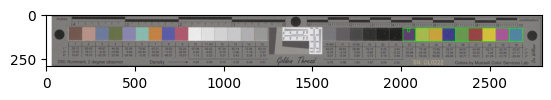

Image: ../images/cropped_scales/fixed\187276113_scale_only.jpg

Pixels per cm: 114.853195164076



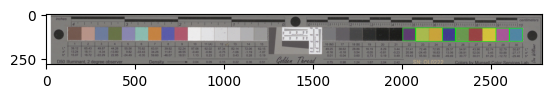

Image: ../images/cropped_scales/fixed\237688423_scale_only.jpg

Pixels per cm: 116.40759930915371



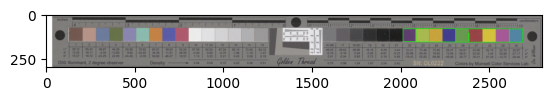

Image: ../images/cropped_scales/fixed\3920620321_scale_only.jpg

Pixels per cm: 103.45423143350604



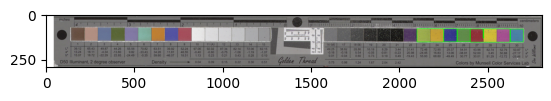

Image: ../images/cropped_scales/fixed\4438036323_scale_only.jpg

Pixels per cm: 103.45423143350604



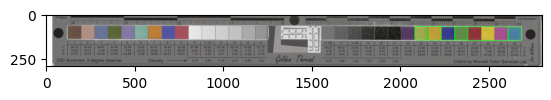

Image: ../images/cropped_scales/fixed\4444272327_scale_only.jpg

Pixels per cm: 104.83592400690846



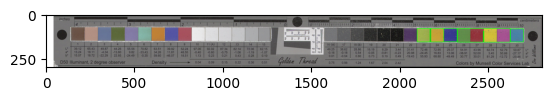

Image: ../images/cropped_scales/fixed\4444273356_scale_only.jpg

Pixels per cm: 105.00863557858376



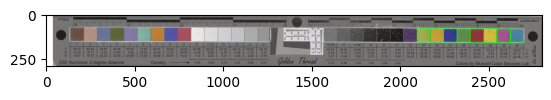

Image: ../images/cropped_scales/fixed\4501696374_scale_only.jpg

Pixels per cm: 103.62694300518135



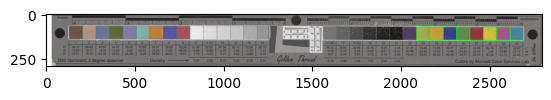

Image: ../images/cropped_scales/fixed\4501699306_scale_only.jpg

Pixels per cm: 114.853195164076



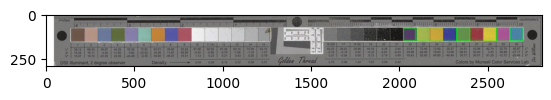

Image: ../images/cropped_scales/fixed\4513096337_scale_only.jpg

Pixels per cm: 102.59067357512953



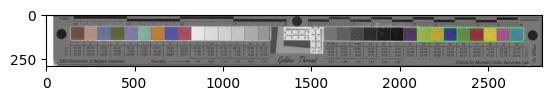

In [4]:
for image in images_scale:
    draw_right_half_contours(image)